# Elon Musks' tweets & Crypto prices correlation

### Project Report

Demetris Englezos

# 1. Introduction - Interesting Questions

#### In this introductory section interesting questions are asked as well as how they will tried to answer. Every day we are bombardized that Elon Musk posted this and that and that influence or had a big impact in the rise or fall of a cryptocurrency value and/or Tesla. Well in this notebook numbers will be set in the everyday quotes using data to analyze how big is the impact of his tweets. To check if he is indeed a "puppet master" of the techno-economical world and if he actualy (and how much) manipulate these prices. 

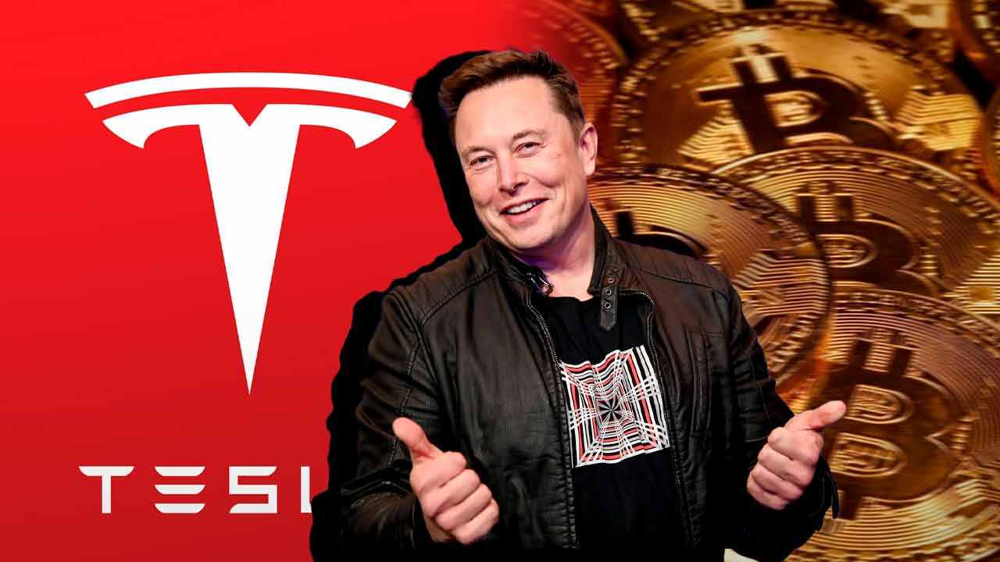

In [404]:
from IPython.display import Image
Image('elon_tesla.jpeg')

# 2. Methodology

#### To investigate what was already discribed in the introduction, we get data from kaggle with all of his tweets and all the prices of Tesla stock, Bitcoin and Dogecoin (open, close, high and low). In the beginning we checked the trend of Elon tweets. For example how often does he tweets, what are topics he is posting about and provide a sentiment analysis of his tweets. Then we have some time analysis of the cryptocurrencies's and Tesla's prices. In the end we check how much the prices change when he tweets about related topics compared to normal rises or falls of the price. Changes in the prices are distinquished if the sentiment of the tweet are positive or negative. 

# 3. Data Analysis

In [405]:
#importing our libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 
import datetime as dt
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [406]:
#importing the related datasets.
df=pd.read_csv('TweetsElon.csv')
dfd=pd.read_csv('DOGE-USD.csv')
dft=pd.read_csv('TSLA.csv')
dfb=pd.read_csv('BTC-USD.csv')

### Important to mention is that for the tweets dataset, we have values until 11-04-2021 while for the crypto and tesla prices until later in October of 2021. For this project we stop until 11-04 to compare tweets and prices 

In [407]:
dft.head(3)

,Date,Open,High,Low,Close,Adj Close,Volume
0,2010-06-29,3.800,5.000,3.508,4.778,4.778,93831500
1,2010-06-30,5.158,6.084,4.660,4.766,4.766,85935500
2,2010-07-01,5.000,5.184,4.054,4.392,4.392,41094000


In [408]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
df.head(2)

,id,conversation_id,created_at,date,time,timezone,user_id,username,name,place,tweet,language,mentions,urls,photos,replies_count,retweets_count,likes_count,hashtags,cashtags,link,retweet,quote_url,video,thumbnail,near,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest
0,1381273474400800773,1381002894032347138,2021-04-11 18:50:33 EEST,2021-04-11,18:50:33,300,44196397,elonmusk,Elon Musk,NaN,@vincent13031925 For now. Costs are decreasing rapidly.,en,[],[],[],640,444,15281,[],[],https://twitter.com/elonmusk/status/1381273474400800773,False,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[{'screen_name': 'vincent13031925', 'name': 'Vincent 🚀🟠', 'id': '1689516060'}]",NaN,NaN,NaN,NaN
1,1381273076709478403,1372444955050971142,2021-04-11 18:48:58 EEST,2021-04-11,18:48:58,300,44196397,elonmusk,Elon Musk,NaN,Love this beautiful shot,en,[],[],[],2464,1517,71161,[],[],https://twitter.com/elonmusk/status/1381273076709478403,False,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN


In [409]:
df.columns

Index(['id', 'conversation_id', 'created_at', 'date', 'time', 'timezone',
       'user_id', 'username', 'name', 'place', 'tweet', 'language', 'mentions',
       'urls', 'photos', 'replies_count', 'retweets_count', 'likes_count',
       'hashtags', 'cashtags', 'link', 'retweet', 'quote_url', 'video',
       'thumbnail', 'near', 'geo', 'source', 'user_rt_id', 'user_rt',
       'retweet_id', 'reply_to', 'retweet_date', 'translate', 'trans_src',
       'trans_dest'],
      dtype='object')

In [410]:
df1=df[['date','time','tweet','likes_count','replies_count','retweets_count','photos','reply_to']]
df1['date']=df1['date'].astype('datetime64')
df1.set_index('date',inplace=True)
df1['year']=df1.index.year

<ipython-input-410-a617de34a3a6>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-410-a617de34a3a6>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [411]:
(df1['reply_to']=='[]').value_counts()

False    8145
True     4417
Name: reply_to, dtype: int64

In [412]:
df1.iloc[29,5]

"['https://pbs.twimg.com/media/EykLyAtU4AEGjqp.jpg']"

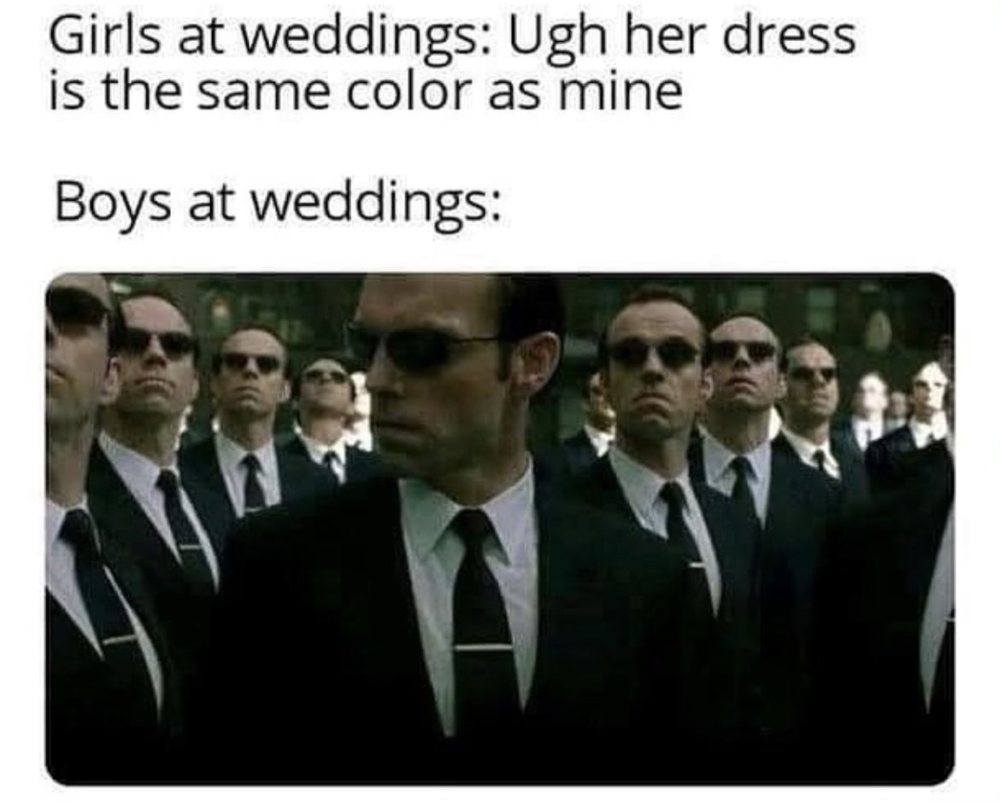

In [413]:
Image("https://pbs.twimg.com/media/EykLyAtU4AEGjqp.jpg",width=500,height=500)

In [414]:
df1['year'].unique()

array([2021, 2020, 2019, 2018, 2017, 2016, 2015, 2014, 2013, 2012, 2011,
       2010], dtype=int64)

In [415]:
df1.head()

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year
date,,,,,,,,
2021-04-11,18:50:33,@vincent13031925 For now. Costs are decreasing rapidly.,15281,640,444,[],"[{'screen_name': 'vincent13031925', 'name': 'Vincent 🚀🟠', 'id': '1689516060'}]",2021
2021-04-11,18:48:58,Love this beautiful shot,71161,2464,1517,[],[],2021
2021-04-11,17:49:38,@agnostoxxx @CathieDWood @ARKInvest Trust the shrub,1380,115,48,[],"[{'screen_name': 'agnostoxxx', 'name': 'Shrubbery Capital', 'id': '188958791...",2021
2021-04-11,15:23:49,The art In Cyberpunk is incredible,228144,8437,10329,[],[],2021
2021-04-11,09:18:47,@itsALLrisky 🤣🤣,7489,446,542,[],"[{'screen_name': 'itsALLrisky', 'name': '💸💸💸', 'id': '1061349266545885185'}]",2021


Text(0.5, 0, 'Year')

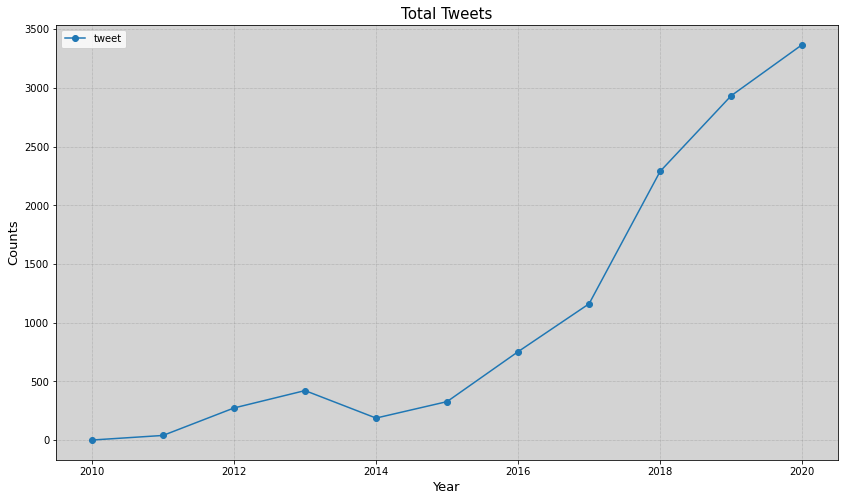

In [416]:
ax=df1[['year','tweet']].groupby(by=['year']).count().head(11).plot(kind='line',style='o-',figsize=(14,8))
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax.set_title('Total Tweets',size=15)
ax.set_facecolor('lightgrey')
ax.set_ylabel('Counts',size=13)
ax.set_xlabel('Year',size=13)

### With the above graph we see that Elon Musk tweets are increasing per year.

Text(0.5, 0, 'Year')

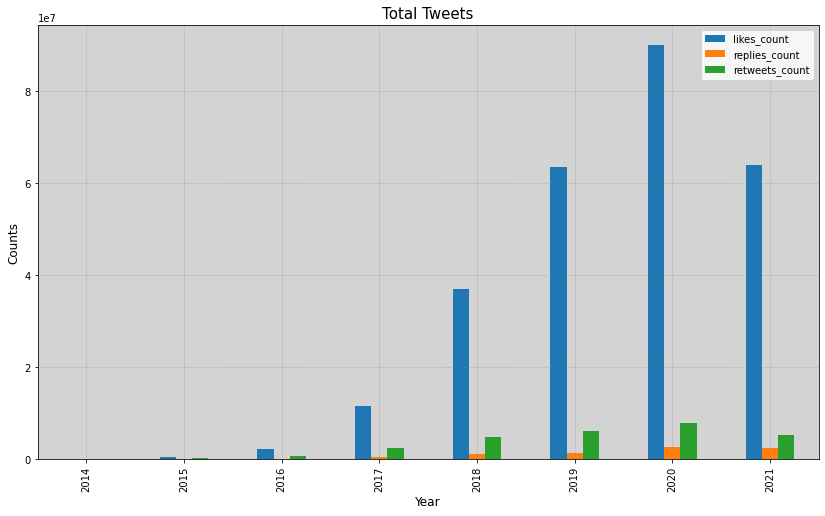

In [417]:
ax=df1.groupby(by=['year']).sum().tail(8).plot(kind='bar',figsize=(14,8))
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax.set_title('Total Tweets',size=15)
ax.set_facecolor('lightgrey')
ax.set_ylabel('Counts',size=12)
ax.set_xlabel('Year',size=12)

### Here we have in the same graph how many likes, replies and retweets follow his tweets per year. In 2021 is lower than 2020 since it's until April. With the same ratio these values will be higher than 2020 by the end of the year

In [418]:
df1.groupby(by=['year']).sum()

,likes_count,replies_count,retweets_count
year,,,
2010,4710,398,349
2011,292316,3973,56398
2012,94622,8723,42760
2013,77136,27776,112147
2014,170658,23544,135146
2015,584741,56613,356838
2016,2229218,116719,721853
2017,11714163,449755,2519931
2018,37091865,1159393,4933960


In [419]:
df1['tweet']=df1['tweet'].str.lower()
df1['tweet'].head()

<ipython-input-419-77a3ee56c415>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



date
2021-04-11    @vincent13031925 for now. costs are decreasing rapidly.
2021-04-11                                   love this beautiful shot
2021-04-11        @agnostoxxx @cathiedwood @arkinvest trust the shrub
2021-04-11                         the art in cyberpunk is incredible
2021-04-11                                            @itsallrisky 🤣🤣
Name: tweet, dtype: object

In [420]:
df1t=df1[df1['tweet'].str.contains('tesla'or'tsla')]
df1b=df1[df1['tweet'].str.contains('bitcoin' or 'btc')]
df1d=df1[df1['tweet'].str.contains('doge')]

In [421]:
df1t.shape

(2378, 8)

In [422]:
df1b.shape
#df1b.head(40)

(16, 8)

In [423]:
df1d.shape

(41, 8)

Text(0.5, 0, 'Year')

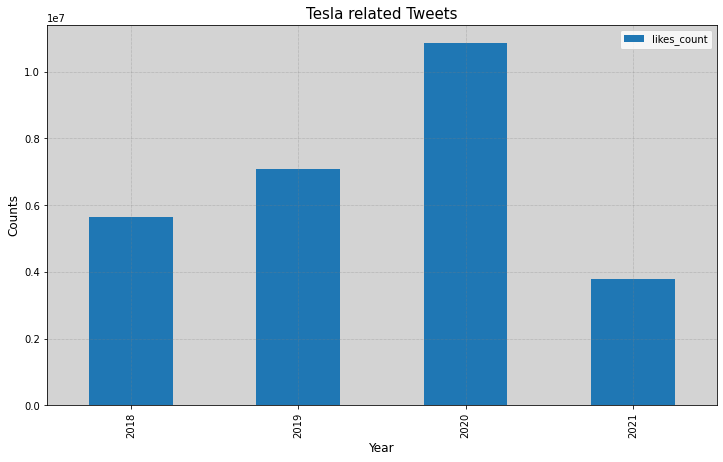

In [424]:
ax1=df1t.groupby(by=['year']).sum().tail(4).plot(kind='bar',y='likes_count',figsize=(12,7))
ax1.set_title('Tesla related Tweets',size=15)
ax1.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax1.set_facecolor('lightgrey')
ax1.set_ylabel('Counts',size=12)
ax1.set_xlabel('Year',size=12)

### Same plot as before but only for Tesla tweets and likes.

In [425]:
df1.head(2)

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year
date,,,,,,,,
2021-04-11,18:50:33,@vincent13031925 for now. costs are decreasing rapidly.,15281,640,444,[],"[{'screen_name': 'vincent13031925', 'name': 'Vincent 🚀🟠', 'id': '1689516060'}]",2021
2021-04-11,18:48:58,love this beautiful shot,71161,2464,1517,[],[],2021


In [426]:
reply=(df1['reply_to']=='[]').value_counts()
replyt=(df1t['reply_to']=='[]').value_counts()
replyb=(df1b['reply_to']=='[]').value_counts()
replyd=(df1d['reply_to']=='[]').value_counts()

In [427]:
replyt

False    1760
True      618
Name: reply_to, dtype: int64

In [428]:
reply.index=['Reply','Tweet']
replyt.index=['Reply','Tweet']
replyb.index=['Reply','Tweet']
replyd.index=['Reply','Tweet']

Text(0.5, 1.0, 'Dogecoin Tweets')

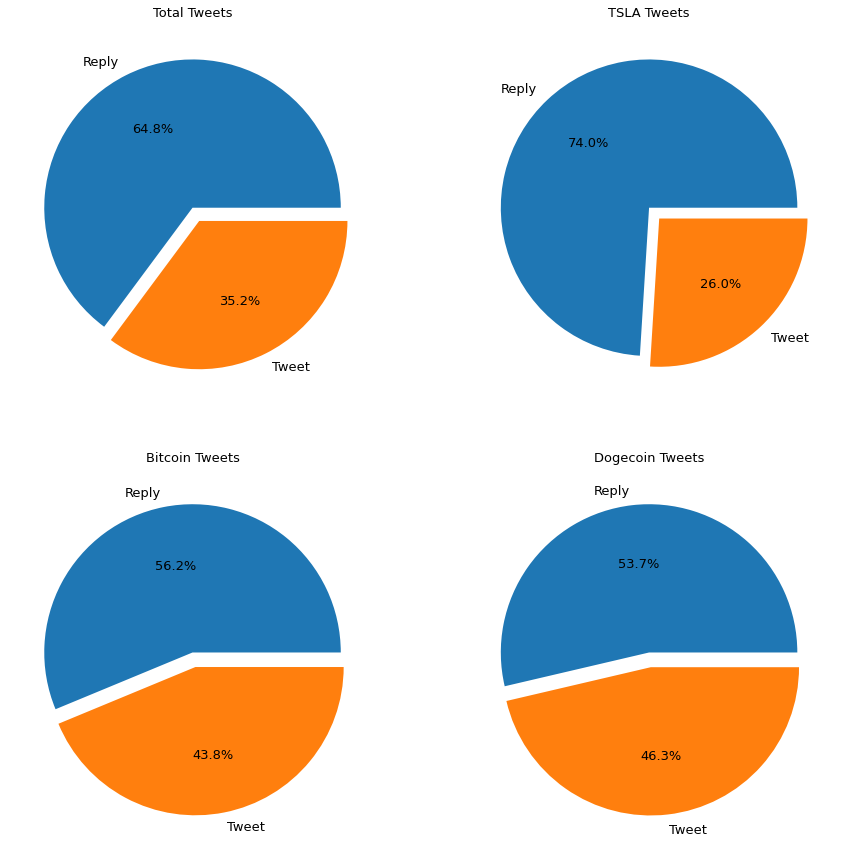

In [429]:
fig=plt.figure(figsize=(15,15))
#fig.suptitle('Elons tweet posts Vs replys',fontsize=18)
ax1=fig.add_subplot(2,2,1)
ax1=reply.plot(kind='pie',labels=reply.index,explode=[0,0.1],ylabel='',autopct='%1.1f%%',fontsize=13)
ax1.set_title('Total Tweets',fontsize=13)
ax2=fig.add_subplot(2,2,2)
ax2=replyt.plot(kind='pie',labels=replyt.index,explode=[0,0.1],ylabel='',autopct='%1.1f%%',fontsize=13)
ax2.set_title('TSLA Tweets',fontsize=13)
ax3=fig.add_subplot(2,2,3)
ax3=replyb.plot(kind='pie',labels=replyb.index,explode=[0,0.1],ylabel='',autopct='%1.1f%%',fontsize=13)
ax3.set_title('Bitcoin Tweets',fontsize=13)
ax4=fig.add_subplot(2,2,4)
ax4=replyd.plot(kind='pie',labels=replyd.index,explode=[0,0.1],ylabel='',autopct='%1.1f%%',fontsize=13)
ax4.set_title('Dogecoin Tweets',fontsize=13)

### Before examining each price, we devided the tweets to Tesla related Tweets, Bitcoin related and Dogecoin related tweets. We see in the pie charts for all the tweets as well as for each stock prices related tweets, what is the percentage of actual tweets (posts) or replys to other Twitter users

In [430]:
(df1t['reply_to']=='[]').value_counts()

False    1760
True      618
Name: reply_to, dtype: int64

In [431]:
df1t[df1t['reply_to']=='[]'].head()

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year
date,,,,,,,,
2021-04-08,12:41:16,thanks tesla suppliers for providing us with critical parts!,187065,5384,6225,[],[],2021
2021-03-24,09:09:34,tesla is using only internal &amp; open source software &amp; operates bitco...,179638,4675,20572,[],[],2021
2021-03-24,09:02:40,you can now buy a tesla with bitcoin,902515,36954,115994,[],[],2021
2021-03-14,16:00:29,play your favorite song in a tesla &amp; turn the volume to 11 you will see...,170455,8327,8287,[],[],2021
2021-03-07,00:47:09,availability varies by region due to regulatory approval delays and/or tesla...,32106,1425,1281,[],[],2021


In [432]:
dft.head(3)

,Date,Open,High,Low,Close,Adj Close,Volume
0,2010-06-29,3.800,5.000,3.508,4.778,4.778,93831500
1,2010-06-30,5.158,6.084,4.660,4.766,4.766,85935500
2,2010-07-01,5.000,5.184,4.054,4.392,4.392,41094000


In [433]:
dft['Date']=dft['Date'].astype('datetime64')
dft.set_index('Date',inplace=True)

In [434]:
dft.tail(3)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2021-10-06,776.200012,786.659973,773.219971,782.750000,782.750000,14632800
2021-10-07,785.460022,805.000000,783.380005,793.609985,793.609985,19195800
2021-10-08,796.210022,796.380005,780.909973,785.489990,785.489990,16711100


In [435]:
import matplotlib.dates as mdates

## Tesla stock Price

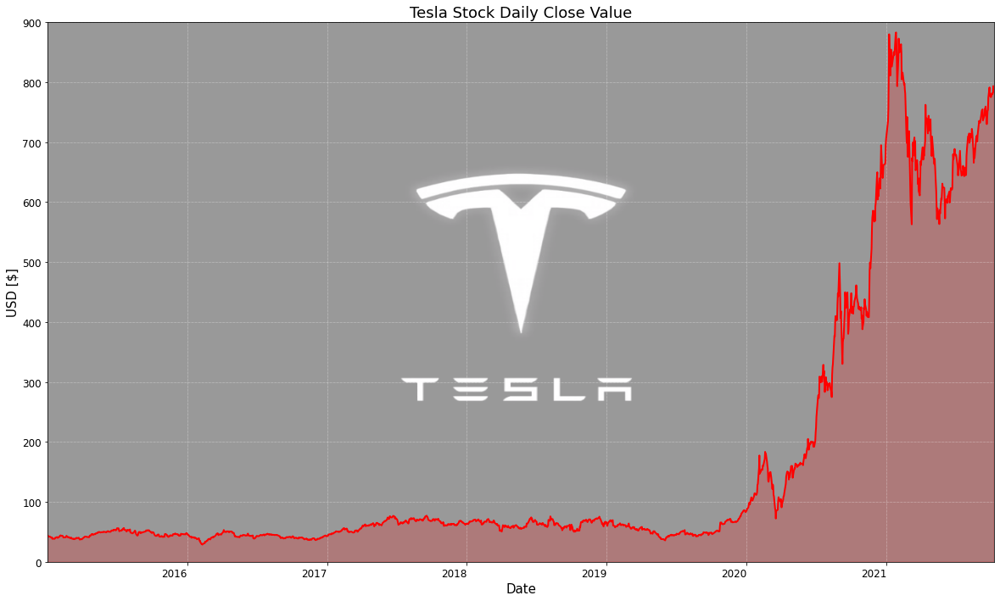

In [436]:
x_lims = list(map(dt.datetime.fromtimestamp, [1420093911, 1633718221]))
x_lims = mdates.date2num(x_lims)
img = plt.imread("blacklogo.png")
ax=dft['Close'][dft.index.year>2013].plot(figsize=(20,13),color='red',linewidth=2)
ax.grid(color='white', linestyle='dotted', linewidth=0.5)
ax.set_title('Tesla Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.fill_between(dft.index,dft['Close'],color='red',alpha=.2)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.imshow(img,aspect='auto',alpha=0.4,extent=[x_lims[0],x_lims[1],0,900])

## Tesla stock Price after 2018

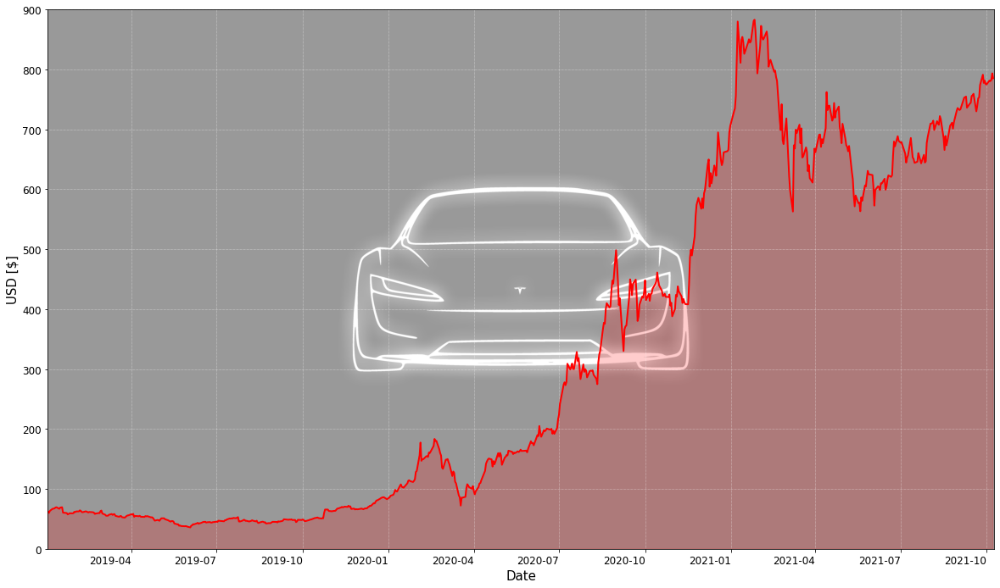

In [437]:
x_lims = list(map(dt.datetime.fromtimestamp, [1546324311, 1633718221]))
x_lims = mdates.date2num(x_lims)
img = plt.imread("blacktesla.png")
ax=dft['Close'][dft.index.year>2018].plot(figsize=(20,13),color='red',linewidth=2)
ax.grid(color='white', linestyle='dotted', linewidth=0.5)
#ax.set_title('Tesla Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.fill_between(dft.index,dft['Close'],color='red',alpha=.2)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.imshow(img,aspect='auto',alpha=0.4,extent=[x_lims[0],x_lims[1],0,900])

In [438]:
dfb['Date']=dfb['Date'].astype('datetime64')
dfb.set_index('Date',inplace=True)

In [439]:
dfb.head(2)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2014-09-17,465.864014,468.174011,452.421997,457.334015,457.334015,21056800.0
2014-09-18,456.859985,456.859985,413.104004,424.440002,424.440002,34483200.0


In [440]:
dfb.tail(2)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2021-10-15,57345.902344,62757.128906,56868.144531,61593.949219,61593.949219,5.178008e+10
2021-10-16,61495.410156,62232.257813,61110.839844,61628.851563,61628.851563,4.469134e+10


## Bitcoin price

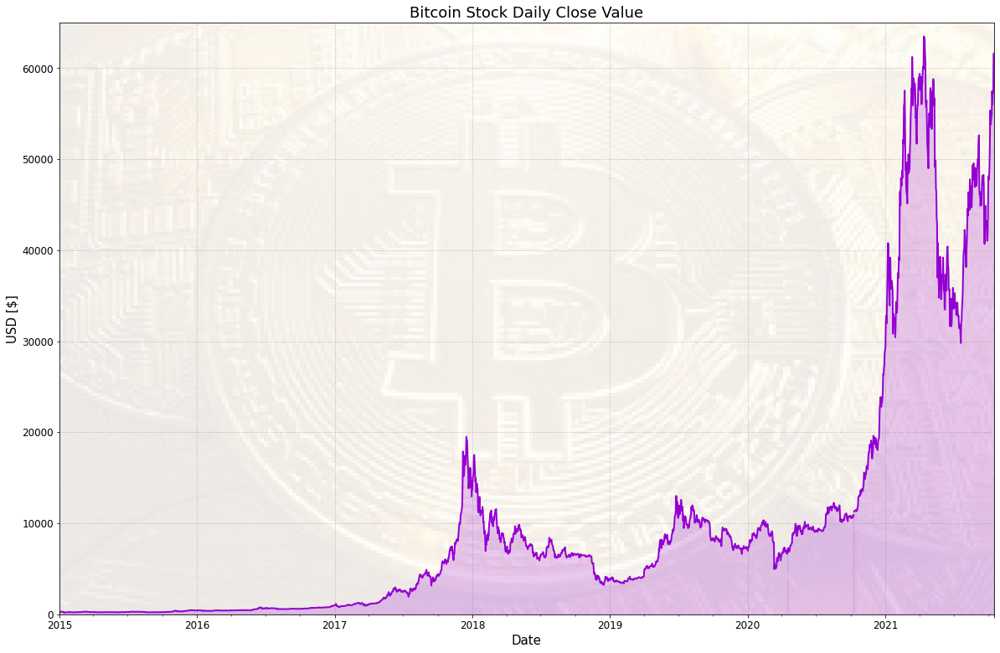

In [441]:
x_lims = list(map(dt.datetime.fromtimestamp, [1420093911, 1641018711]))
x_lims = mdates.date2num(x_lims)
img = plt.imread("bitcoin.jfif")
ax=dfb['Close'][dfb.index.year>2014].plot(figsize=(20,13),color='darkviolet',linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax.set_title('Bitcoin Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.fill_between(dfb.index,dfb['Close'],color='darkviolet',alpha=.2)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.imshow(img,aspect='auto',alpha=0.1,extent=[x_lims[0],x_lims[1],0,65000])

## Bitcoin price after 2016

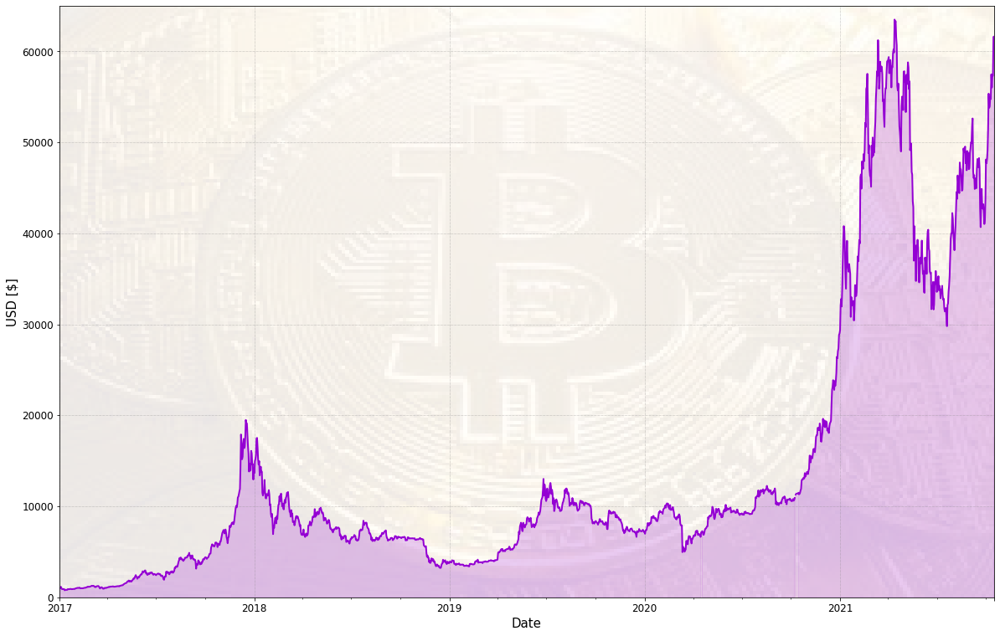

In [442]:
x_lims = list(map(dt.datetime.fromtimestamp, [1483252311, 1641018711]))
x_lims = mdates.date2num(x_lims)
img = plt.imread("bitcoin.jfif")
ax=dfb['Close'][dfb.index.year>2016].plot(figsize=(20,13),color='darkviolet',linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax.set_title('Bitcoin Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.fill_between(dfb.index,dfb['Close'],color='darkviolet',alpha=.2)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.imshow(img,aspect='auto',alpha=0.1,extent=[x_lims[0],x_lims[1],0,65000])

In [443]:
dfd['Date']=dfd['Date'].astype('datetime64')
dfd.set_index('Date',inplace=True)

In [444]:
dfd.head(2)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2014-09-17,0.000293,0.000299,0.000260,0.000268,0.000268,1463600.0
2014-09-18,0.000268,0.000325,0.000267,0.000298,0.000298,2215910.0


## Dogecoin price

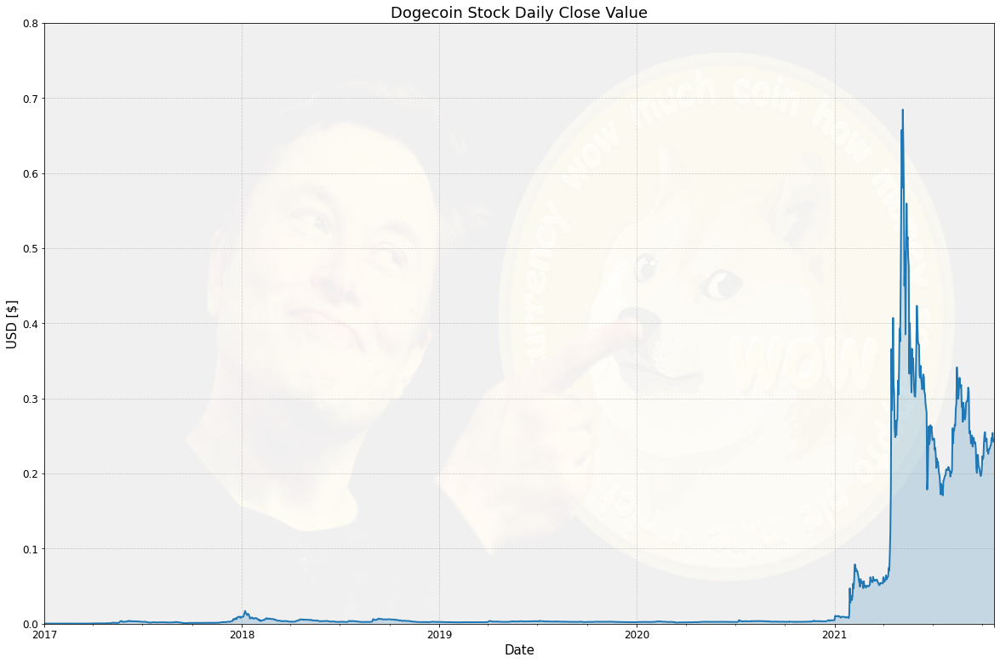

In [445]:
x_lims = list(map(dt.datetime.fromtimestamp, [1483252311, 1641018711]))
x_lims = mdates.date2num(x_lims)
img = plt.imread("doge1.jpg")
ax=dfd['Close'][dfd.index.year>2016].plot(figsize=(20,13),linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax.set_title('Dogecoin Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.fill_between(dfd.index,dfd['Close'],alpha=.2)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.imshow(img,aspect='auto',alpha=0.06,extent=[x_lims[0],x_lims[1],0,0.8])

## Dogecoin price after 2020

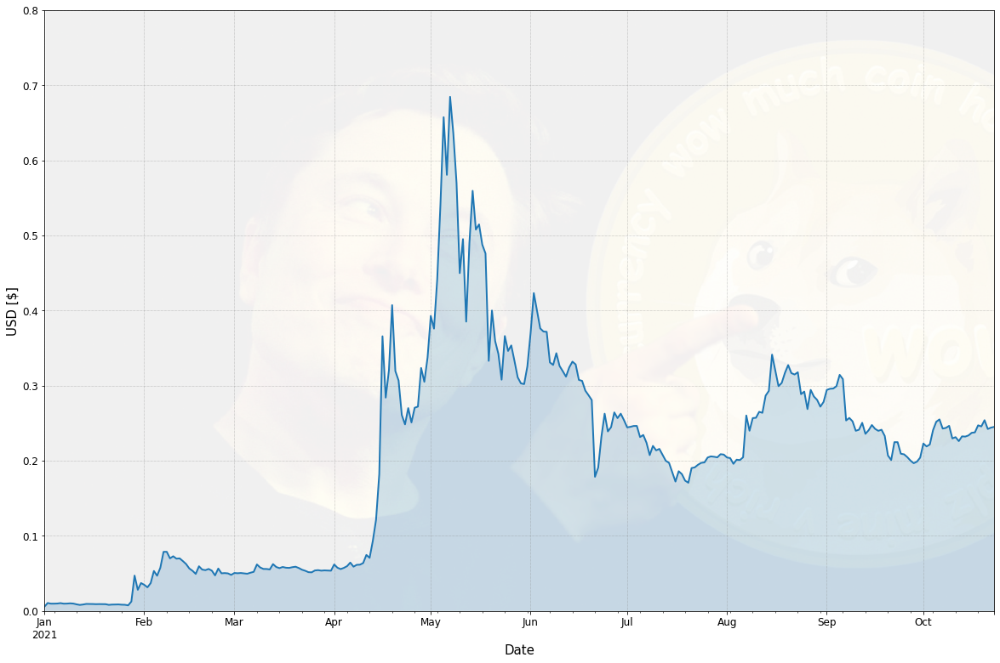

In [446]:
x_lims = list(map(dt.datetime.fromtimestamp, [1609482711, 1641018711]))
x_lims = mdates.date2num(x_lims)
img = plt.imread("doge1.jpg")
ax=dfd['Close'][dfd.index.year>2020].plot(figsize=(20,13),linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax.set_title('Dogecoin Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.fill_between(dfd.index,dfd['Close'],alpha=.2)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.imshow(img,aspect='auto',alpha=0.06,extent=[x_lims[0],x_lims[1],0,0.8])

In [447]:
import plotly.graph_objects as go

In [448]:
dft.head(2)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-06-29,3.800,5.000,3.508,4.778,4.778,93831500
2010-06-30,5.158,6.084,4.660,4.766,4.766,85935500


## Below we have the candlestick chart for tesla which is also interactive.

In [449]:
dft2=(dft[dft.index.year>2019]).copy()
fig = go.Figure(data=[go.Candlestick(x=(dft2.index),
                open=dft2['Open'],
                high=dft2['High'],
                low=dft2['Low'],
                close=dft2['Close'])],
                layout=go.Layout(height=700, width=950,title='Tesla Candlestick Chart'))
fig.show()

## Bitcoin Candlestic Chart

In [450]:
dfb2=(dfb[dfb.index.year>2019]).copy()
fig = go.Figure(data=[go.Candlestick(x=(dfb2.index),
                open=dfb2['Open'],
                high=dfb2['High'],
                low=dfb2['Low'],
                close=dfb2['Close'])],
                layout=go.Layout(height=700, width=950,title='Bitcoin Candlestick Chart'))
fig.show()

## Dogecoin Candlestic Chart

In [451]:
dfd2=(dfd[dfd.index.year>2020]).copy()
fig = go.Figure(data=[go.Candlestick(x=(dfd2.index),
                open=dfd2['Open'],
                high=dfd2['High'],
                low=dfd2['Low'],
                close=dfd2['Close'])],
                layout=go.Layout(height=700, width=950,title='Dogecoin Candlestick Chart'))
fig.show()

## Now we want to see the most used words in the tweets of Elon Musk in total and when he tweets about tesla, bitcoin or dogecoin. We check this using Word Clouds

In [452]:
df1t.shape[0]

2378

In [453]:
df1t.head(2)

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year
date,,,,,,,,
2021-04-10,11:32:35,@tesla_adri @wholemarsblog these things are best thought of as probabilities...,2310,204,114,[],"[{'screen_name': 'tesla_adri', 'name': 'Tesla_Adri', 'id': '1321117860844965...",2021
2021-04-10,04:07:04,@austinteslaclub @owensparks_ @wholemarsblog good point. next major softwa...,2487,210,138,[],"[{'screen_name': 'AustinTeslaClub', 'name': 'Tesla Owners of Austin', 'id': ...",2021


na valw kai gia oula ta tweets

In [454]:
tesla_tweet=[]
i=0
for i in range(df1t.shape[0]):
    tesla_tweet.append(df1t.iloc[i,1])
    i+=1  

In [455]:
bitcoin_tweet=[]
i=0
for i in range(df1b.shape[0]):
    bitcoin_tweet.append(df1b.iloc[i,1])
    i+=1  

In [456]:
dogecoin_tweet=[]
i=0
for i in range(df1d.shape[0]):
    dogecoin_tweet.append(df1d.iloc[i,1])
    i+=1 

In [457]:
elon_tweet=[]
i=0
for i in range(df1.shape[0]):
    elon_tweet.append(df1.iloc[i,1])
    i+=1 

In [458]:
from PIL import Image
import numpy as np
tesla_mask = np.array(Image.open("model3.jpg"))
bitcoin_mask=np.array(Image.open("bitco.png"))
dogecoin_mask=np.array(Image.open("doge3.png"))
elon_mask=np.array(Image.open('elon4.png'))

In [459]:
from wordcloud import WordCloud, STOPWORDS
stopwords = set(STOPWORDS)

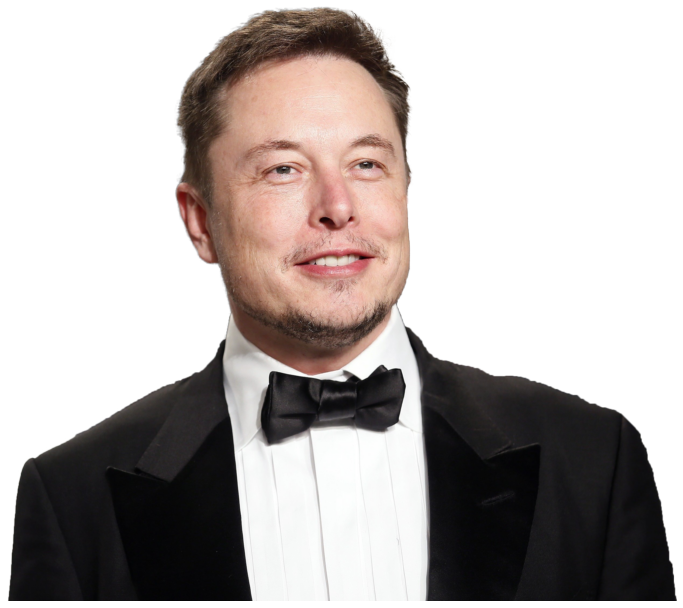

In [460]:
fig = plt.figure()
fig.set_figwidth(12) # set width
fig.set_figheight(16) # set height

plt.imshow(elon_mask, cmap=plt.cm.gray, interpolation='bilinear')
plt.axis('off')
plt.show()

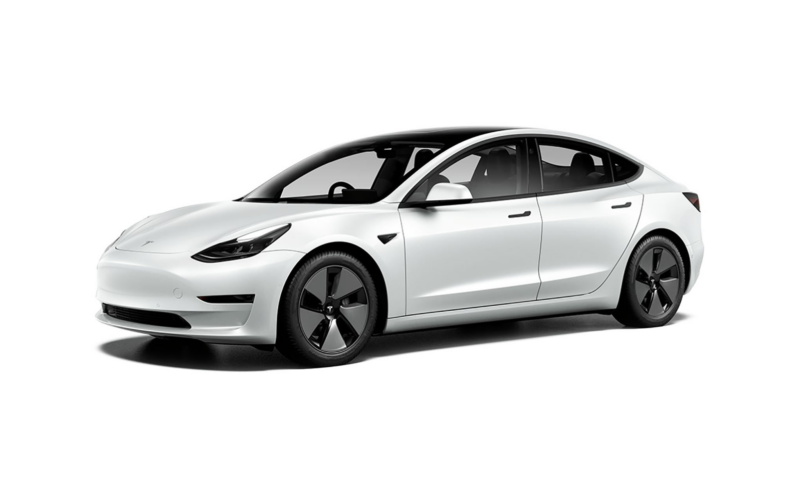

In [461]:
fig = plt.figure()
fig.set_figwidth(14) # set width
fig.set_figheight(18) # set height

plt.imshow(tesla_mask, cmap=plt.cm.gray, interpolation='bilinear')
plt.axis('off')
plt.show()

In [462]:
def listToString(s): 
    
    # initialize an empty string
    str1 = "" 
    
    # traverse in the string  
    for ele in s: 
        str1 += ele  
    
    # return string  
    return str1 
        
        
# Driver code    
tesla_tweet=(listToString(tesla_tweet)) 
bitcoin_tweet=(listToString(bitcoin_tweet)) 
dogecoin_tweet=(listToString(dogecoin_tweet)) 
elon_tweet=(listToString(elon_tweet)) 

In [463]:
stopwords.add('@') # add the words said to stopwords
stopwords.add('https') 

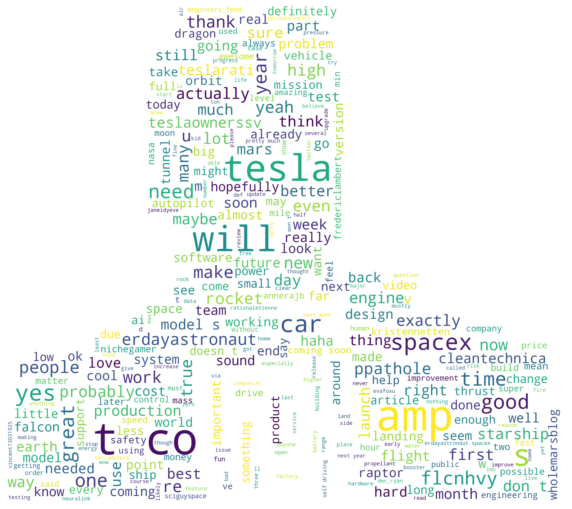

In [464]:
# instantiate a word cloud object
elon_wc = WordCloud(background_color='white', max_words=300, mask=elon_mask, stopwords=stopwords)

# generate the word cloud
elon_wc.generate(elon_tweet)

# display the word cloud
fig = plt.figure()
fig.set_figwidth(10) # set width
fig.set_figheight(14) # set height

plt.imshow(elon_wc, interpolation='bilinear')
plt.axis('off')
plt.show()

#### We can see above that among all of Elon's tweets, the most used words like "tesla", "car", "mars", "spacex", "launch" etc

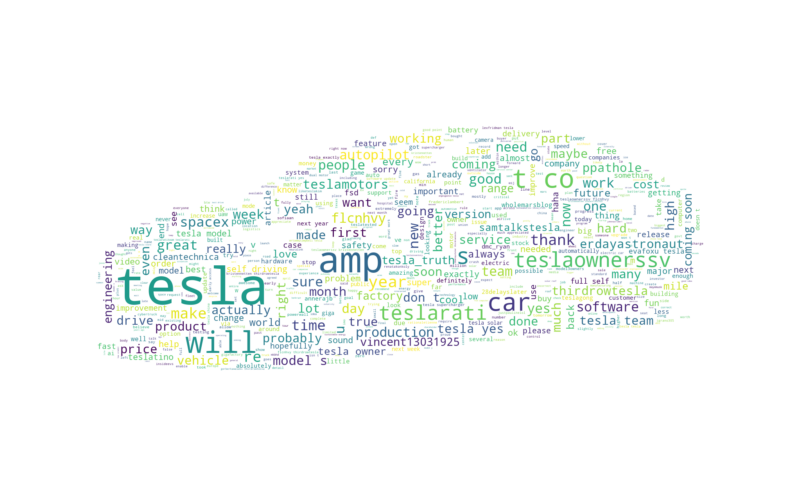

In [465]:
# instantiate a word cloud object
tesla_wc = WordCloud(background_color='white', max_words=600, mask=tesla_mask, stopwords=stopwords)

# generate the word cloud
tesla_wc.generate(tesla_tweet)

# display the word cloud
fig = plt.figure()
fig.set_figwidth(14) # set width
fig.set_figheight(18) # set height

plt.imshow(tesla_wc, interpolation='bilinear')
plt.axis('off')
plt.show()

#### When he tweets about tesla, obviously the most used word is "tesla". Other words are "car", "teslaowner" and "will" that maybe show that he give promises etc.

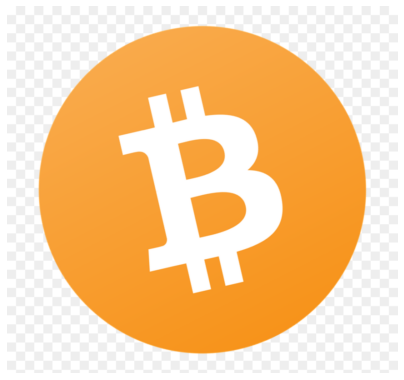

In [466]:
fig = plt.figure()
fig.set_figwidth(7) # set width
fig.set_figheight(11) # set height

plt.imshow(bitcoin_mask, cmap=plt.cm.gray, interpolation='bilinear')
plt.axis('off')
plt.show()

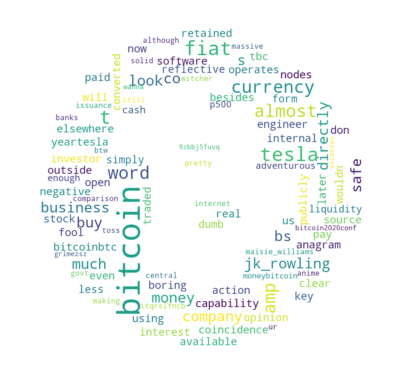

In [467]:
# instantiate a word cloud object
bitcoin_wc = WordCloud(background_color='white', max_words=1000, mask=bitcoin_mask, stopwords=stopwords)

# generate the word cloud
bitcoin_wc.generate(bitcoin_tweet)

# display the word cloud
fig = plt.figure()
fig.set_figwidth(7) # set width
fig.set_figheight(11) # set height

plt.imshow(bitcoin_wc, interpolation='bilinear')
plt.axis('off')
plt.show()

#### When he tweets about Dogecoin he uses a lot "publicly", "currency", but also "tesla" etc. 

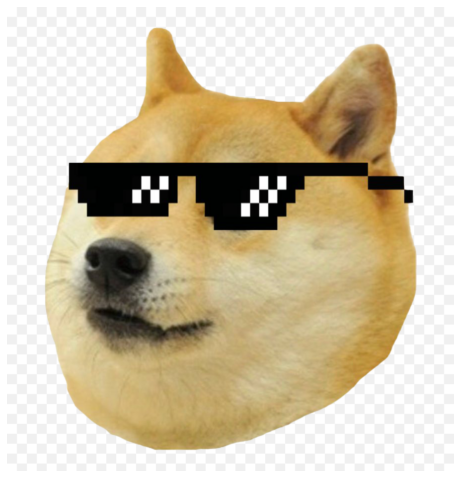

In [468]:
fig = plt.figure()
fig.set_figwidth(8) # set width
fig.set_figheight(12) # set height

plt.imshow(dogecoin_mask, cmap=plt.cm.gray, interpolation='bilinear')
plt.axis('off')
plt.show()

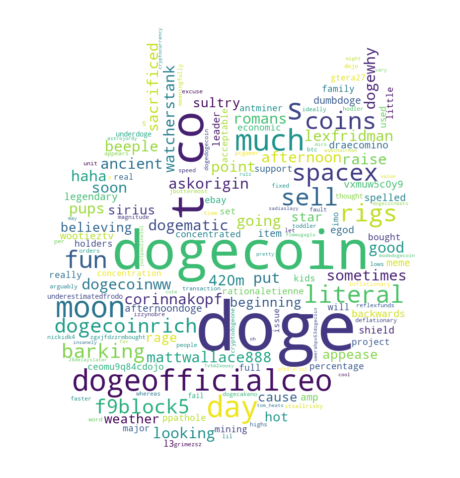

In [469]:
# instantiate a word cloud object
dogecoin_wc = WordCloud(background_color='white', max_words=500, mask=dogecoin_mask, stopwords=stopwords)

# generate the word cloud
dogecoin_wc.generate(dogecoin_tweet)

# display the word cloud
fig = plt.figure()
fig.set_figwidth(8) # set width
fig.set_figheight(12) # set height

plt.imshow(dogecoin_wc, interpolation='bilinear')
plt.axis('off')
plt.show()

#### Finally when he posts about dogecoin he uses: "spacex", coins", "sell" etc.

## Later in this analysis we investigate the sentiment of the tweets
#### First sentiment analysis of total tweets and then for Tesla, Bitcoin and Dogecoin

In [470]:
import re

# Clean The Data
def cleantext(text):
    text = re.sub(r"@[A-Za-z0-9]+", "", text) # Remove Mentions
    text = re.sub(r"#", "", text) # Remove Hashtags Symbol
    text = re.sub(r"RT[\s]+", "", text) # Remove Retweets
    text = re.sub(r"https?:\/\/\S+", "", text) # Remove The Hyper Link
    
    return text

In [471]:
import nltk
#nltk.download()

In [472]:
from nltk.sentiment import SentimentIntensityAnalyzer

In [473]:
sia = SentimentIntensityAnalyzer()

In [474]:
df1['tweet_clean']=df1['tweet'].apply(cleantext)
df1t['tweet_clean']=df1t['tweet'].apply(cleantext)
df1b['tweet_clean']=df1b['tweet'].apply(cleantext)
df1d['tweet_clean']=df1d['tweet'].apply(cleantext)

<ipython-input-474-a2202d136a49>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-474-a2202d136a49>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-474-a2202d136a49>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-474-a22

In [475]:
df1['neg']=0
df1['neu']=0
df1['pos']=0
df1t['neg']=0
df1t['neu']=0
df1t['pos']=0
df1b['neg']=0
df1b['neu']=0
df1b['pos']=0
df1d['neg']=0
df1d['neu']=0
df1d['pos']=0

<ipython-input-475-962cbeb3a9ea>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-475-962cbeb3a9ea>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-475-962cbeb3a9ea>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-475-962

In [476]:
pd.set_option('display.max_colwidth',80)
df1[['tweet','tweet_clean']].head(5)

,tweet,tweet_clean
date,,
2021-04-11,@vincent13031925 for now. costs are decreasing rapidly.,for now. costs are decreasing rapidly.
2021-04-11,love this beautiful shot,love this beautiful shot
2021-04-11,@agnostoxxx @cathiedwood @arkinvest trust the shrub,trust the shrub
2021-04-11,the art in cyberpunk is incredible,the art in cyberpunk is incredible
2021-04-11,@itsallrisky 🤣🤣,🤣🤣


In [477]:
pd.set_option('display.max_colwidth', 80)
df1t[['tweet','tweet_clean']].head()

,tweet,tweet_clean
date,,
2021-04-10,@tesla_adri @wholemarsblog these things are best thought of as probabilities...,_adri these things are best thought of as probabilities. there are 5 forwar...
2021-04-10,@austinteslaclub @owensparks_ @wholemarsblog good point. next major softwa...,_ good point. next major software rev will do much better with automatin...
2021-04-10,@teslaownerssv @neuralink turns out 🐒 love video games &amp; snacks just lik...,turns out 🐒 love video games &amp; snacks just like us!
2021-04-09,@teslagong yeah,yeah
2021-04-09,@ihearttesla absolutely doable. possibly as soon as neuralink device version...,"absolutely doable. possibly as soon as neuralink device version 2, highly l..."


In [478]:
df1t.head(2)

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year,tweet_clean,neg,neu,pos
date,,,,,,,,,,,,
2021-04-10,11:32:35,@tesla_adri @wholemarsblog these things are best thought of as probabilities...,2310,204,114,[],"[{'screen_name': 'tesla_adri', 'name': 'Tesla_Adri', 'id': '1321117860844965...",2021,_adri these things are best thought of as probabilities. there are 5 forwar...,0,0,0
2021-04-10,04:07:04,@austinteslaclub @owensparks_ @wholemarsblog good point. next major softwa...,2487,210,138,[],"[{'screen_name': 'AustinTeslaClub', 'name': 'Tesla Owners of Austin', 'id': ...",2021,_ good point. next major software rev will do much better with automatin...,0,0,0


In [479]:
df1t.iloc[0,8]

'_adri  these things are best thought of as probabilities. there are 5 forward-facing cameras. it is highly likely that at least one of them will see multiple cars ahead.'

In [480]:
df1d.head(2)

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year,tweet_clean,neg,neu,pos
date,,,,,,,,,,,,
2021-04-08,23:45:19,@dogeofficialceo @watcherstank @spacex looking at pups soon!,4081,454,467,[],"[{'screen_name': 'dogeofficialceo', 'name': 'Sir Doge of the Coin 🐶', 'id': ...",2021,looking at pups soon!,0,0,0
2021-04-01,13:25:23,spacex is going to put a literal dogecoin on the literal moon,535373,25947,50139,[],[],2021,spacex is going to put a literal dogecoin on the literal moon,0,0,0


In [481]:
df1.iloc[0,11]

0

In [482]:
i=0
for i in range (df1.shape[0]):
    x=sia.polarity_scores(df1.iloc[i,8])
    df1.iloc[i,9]=x['neg']
    df1.iloc[i,10]=x['neu']
    df1.iloc[i,11]=x['pos']
    i+=1

c:\users\demetris englezos\appdata\local\programs\python\python39\lib\site-packages\pandas\core\indexing.py:1720: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [483]:
i=0
for i in range (df1t.shape[0]):
    x=sia.polarity_scores(df1t.iloc[i,8])
    df1t.iloc[i,9]=x['neg']
    df1t.iloc[i,10]=x['neu']
    df1t.iloc[i,11]=x['pos']
    i+=1

In [484]:
i=0
for i in range (df1b.shape[0]):
    x=sia.polarity_scores(df1b.iloc[i,8])
    df1b.iloc[i,9]=x['neg']
    df1b.iloc[i,10]=x['neu']
    df1b.iloc[i,11]=x['pos']
    i+=1

In [485]:
i=0
for i in range (df1d.shape[0]):
    x=sia.polarity_scores(df1d.iloc[i,8])
    df1d.iloc[i,9]=x['neg']
    df1d.iloc[i,10]=x['neu']
    df1d.iloc[i,11]=x['pos']
    i+=1

In [486]:
df1t[['tweet_clean','neg','neu','pos']].head(5)

,tweet_clean,neg,neu,pos
date,,,,
2021-04-10,_adri these things are best thought of as probabilities. there are 5 forwar...,0.0,0.865,0.135
2021-04-10,_ good point. next major software rev will do much better with automatin...,0.0,0.823,0.177
2021-04-10,turns out 🐒 love video games &amp; snacks just like us!,0.0,0.534,0.466
2021-04-09,yeah,0.0,0.000,1.000
2021-04-09,"absolutely doable. possibly as soon as neuralink device version 2, highly l...",0.0,1.000,0.000


In [487]:
df1[['tweet_clean','neg','neu','pos']].head(5)

,tweet_clean,neg,neu,pos
date,,,,
2021-04-11,for now. costs are decreasing rapidly.,0.0,1.000,0.000
2021-04-11,love this beautiful shot,0.0,0.198,0.802
2021-04-11,trust the shrub,0.0,0.377,0.623
2021-04-11,the art in cyberpunk is incredible,0.0,1.000,0.000
2021-04-11,🤣🤣,0.0,1.000,0.000


In [488]:
type(df1[['neg','neu','pos']].mean()/(df1[['neg','neu','pos']].mean().sum()/100))

pandas.core.series.Series

In [489]:
type(df1[['neg','neu','pos']].mean())

pandas.core.series.Series

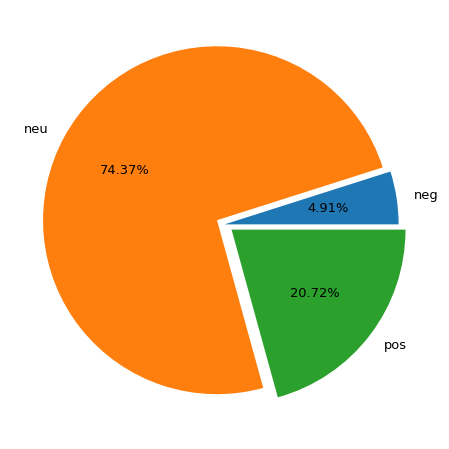

In [490]:
ax=(df1[['neg','neu','pos']].mean()/(df1[['neg','neu','pos']].mean().sum()/100)).plot(kind='pie',figsize=(12,8),explode=[0,0.05,0.05],ylabel='',autopct='%1.2f%%',fontsize=13)
#ax.set_title('Sentiment analysis for Elon Musk tweets',fontsize=16)

### Sentiment analysis showed in the beginning that there are a lot of neutral tweets. This makes sense since most of the tweets are short and the related libraries can't recognise if the tweet is positive or negative. However out of the tweets that we got positive or negative results, we see that Elon's tweets tend to be more positive.

In [491]:
negt=df1t['neg'][df1t['neg']>0].sum()/(df1t.shape[0])
negb=df1b['neg'][df1b['neg']>0].sum()/(df1b.shape[0])
negd=df1d['neg'][df1d['neg']>0].sum()/(df1d.shape[0])

In [492]:
neu=df1t['neu'].sum()

In [493]:
post=df1t['pos'][df1t['pos']>0].sum()/(df1t.shape[0])
posb=df1b['pos'][df1b['pos']>0].sum()/(df1b.shape[0])
posd=df1d['pos'][df1d['pos']>0].sum()/(df1d.shape[0])

In [494]:
neut=df1t['neu'][df1t['neu']>0].sum()/(df1t.shape[0])
neub=df1b['neu'][df1b['neu']>0].sum()/(df1b.shape[0])
neud=df1d['neu'][df1d['neu']>0].sum()/(df1d.shape[0])

In [495]:
df1d['neg'][df1d['neg']>0].mean()

0.36233333333333334

In [496]:
df1d['pos'][df1d['pos']>0].mean()

0.32827272727272727

In [497]:
scoret=[negt,neut ,post]
scoreb=[negb,neub,posb]
scored=[negd,neud,posd]
names=['negative','neutral','positive']

na valw kai ta antistixa gia bitcoin kai doge \
episis na kanw scatter plot me positive negative \
episis otan tha valw kathetes grames mazi me stock prices na exei allo xroma an einai arnitiko i thetiko

In [498]:
sent=pd.DataFrame(names)

In [499]:
sent['tesla']=scoret
sent['bitcoin']=scoreb
sent['dogecoin']=scored

In [500]:
sent

,0,tesla,bitcoin,dogecoin
0,negative,0.043844,0.034875,0.053024
1,neutral,0.728169,0.826625,0.834512
2,positive,0.217471,0.076000,0.088073


In [501]:
sent.set_index(0,inplace=True)
sent

,tesla,bitcoin,dogecoin
0,,,
negative,0.043844,0.034875,0.053024
neutral,0.728169,0.826625,0.834512
positive,0.217471,0.076000,0.088073


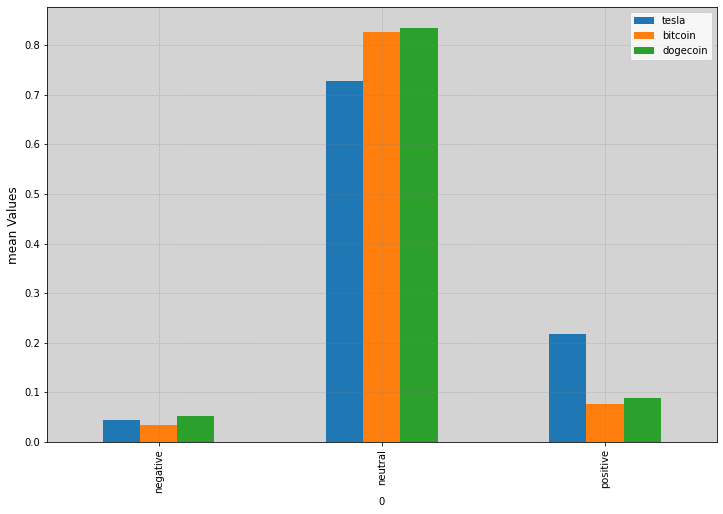

In [502]:
ax1=sent[['tesla','bitcoin','dogecoin']].plot(kind='bar',figsize=(12,8))
ax1.set_ylabel('mean Values',fontsize=12)
ax1.set_facecolor('lightgrey')
ax1.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax1.set_title('Sentiment analysis for Elon Musk tweets related to Tesla, Bitcoin, Dogecoin',fontsize=16)

### In the above figure we check the sentiment of tweets when he posts about tesla, bitcoin and dogecoin. The same outputs like the total tweets can be drawn.

In [503]:
df1t.head(2)

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year,tweet_clean,neg,neu,pos
date,,,,,,,,,,,,
2021-04-10,11:32:35,@tesla_adri @wholemarsblog these things are best thought of as probabilities...,2310,204,114,[],"[{'screen_name': 'tesla_adri', 'name': 'Tesla_Adri', 'id': '1321117860844965...",2021,_adri these things are best thought of as probabilities. there are 5 forwar...,0.0,0.865,0.135
2021-04-10,04:07:04,@austinteslaclub @owensparks_ @wholemarsblog good point. next major softwa...,2487,210,138,[],"[{'screen_name': 'AustinTeslaClub', 'name': 'Tesla Owners of Austin', 'id': ...",2021,_ good point. next major software rev will do much better with automatin...,0.0,0.823,0.177


In [504]:
df1.reset_index()

,date,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year,tweet_clean,neg,neu,pos
0,2021-04-11,18:50:33,@vincent13031925 for now. costs are decreasing rapidly.,15281,640,444,[],"[{'screen_name': 'vincent13031925', 'name': 'Vincent 🚀🟠', 'id': '1689516060'}]",2021,for now. costs are decreasing rapidly.,0.000,1.000,0.000
1,2021-04-11,18:48:58,love this beautiful shot,71161,2464,1517,[],[],2021,love this beautiful shot,0.000,0.198,0.802
2,2021-04-11,17:49:38,@agnostoxxx @cathiedwood @arkinvest trust the shrub,1380,115,48,[],"[{'screen_name': 'agnostoxxx', 'name': 'Shrubbery Capital', 'id': '188958791...",2021,trust the shrub,0.000,0.377,0.623
3,2021-04-11,15:23:49,the art in cyberpunk is incredible,228144,8437,10329,[],[],2021,the art in cyberpunk is incredible,0.000,1.000,0.000
4,2021-04-11,09:18:47,@itsallrisky 🤣🤣,7489,446,542,[],"[{'screen_name': 'itsALLrisky', 'name': '💸💸💸', 'id': '1061349266545885185'}]",2021,🤣🤣,0.000,1.000,0.000
5,2021-04-11,02:56:43,@seinfeldguru @wholemarsblog nope haha,2536,234,65,[],"[{'screen_name': 'seinfeldguru', 'name': 'Rosalie', 'id': '140074404'}, {'sc...",2021,nope haha,0.713,0.287,0.000
6,2021-04-11,02:54:51,"@wholemarsblog if you don’t say anything &amp; engage autopilot, it will soo...",2625,222,201,[],"[{'screen_name': 'WholeMarsBlog', 'name': 'Whole Mars Catalog', 'id': '12634...",2021,"if you don’t say anything &amp; engage autopilot, it will soon guess based ...",0.000,0.921,0.079
7,2021-04-11,02:52:21,@deltavphotos @portcanaveral that rocket is a hardcore veteran of many missions,11956,214,296,[],"[{'screen_name': 'DeltavPhotos', 'name': 'ΔV Photos 🚀', 'id': '1255532858514...",2021,that rocket is a hardcore veteran of many missions,0.000,1.000,0.000
8,2021-04-11,01:09:02,blimps rock https://t.co/e8cu5fknoi,165302,8811,6661,['https://pbs.twimg.com/media/EypR8OrU8AEZxTl.jpg'],[],2021,blimps rock,0.000,1.000,0.000
9,2021-04-10,23:22:20,"@engineers_feed due to lower gravity, you can travel from surface of mars to...",48034,1595,1936,[],"[{'screen_name': 'engineers_feed', 'name': 'World of Engineering', 'id': '34...",2021,"_feed due to lower gravity, you can travel from surface of mars to surface o...",0.072,0.850,0.078


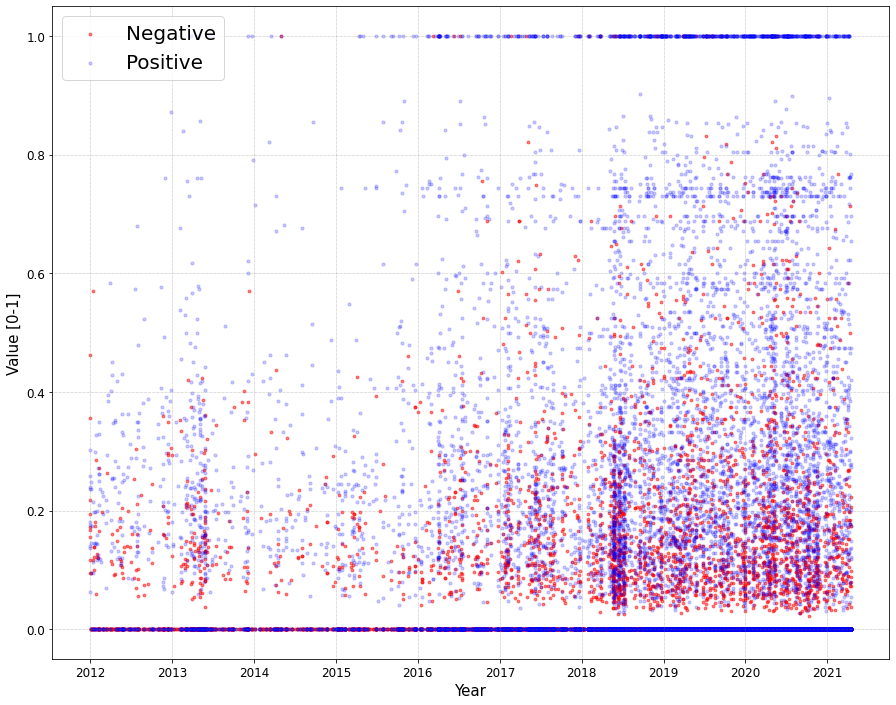

In [505]:
ax1=df1.reset_index()[(df1.index.year>2011)].plot(kind='scatter',x='date',y='neg',figsize=(15,12),s=8,color='red',ylabel='value [0-1]',alpha=0.5)
ax2=ax1
ax2=df1.reset_index()[(df1.index.year>2011)].plot(kind='scatter',x='date',y='pos',color='blue',s=10,ax=ax2,alpha=0.2)
#ax2.set_facecolor('lightgrey')
ax2.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax2.set_ylabel('Value [0-1]',fontsize=15)
ax2.set_xlabel('Year',fontsize=15)
ax2.tick_params(axis='both',which='major',labelsize=12)
#ax2.set_title('Positive and Negative value of the tweets from Sentiment analysis',fontsize=16)
ax2.legend(['Negative','Positive'],loc='upper left',fontsize=20)

### As already mentioned above his tweets are more positive and it's also shown in the graph above for all tweets where the red dots (positive) are more and also have higher values. On the other hand blue dots (negative) are less and have lower values

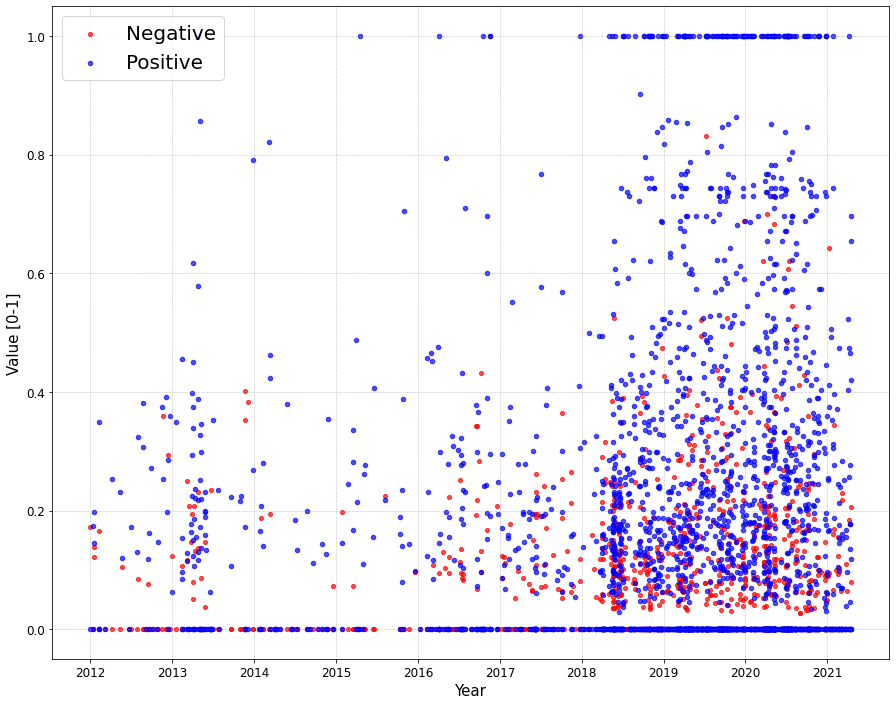

In [506]:
ax1=df1t.reset_index().plot(kind='scatter',x='date',y='neg',figsize=(15,12),s=17,color='red',ylabel='value [0-1]',alpha=0.7)
ax2=ax1
ax2=df1t.reset_index().plot(kind='scatter',x='date',y='pos',color='blue',s=20,ax=ax2,alpha=0.7)
#ax2.set_facecolor('lightgrey')
ax2.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax2.set_ylabel('Value [0-1]',fontsize=15)
ax2.set_xlabel('Year',fontsize=15)
ax2.tick_params(axis='both',which='major',labelsize=12)
#ax2.set_title('Positive and Negative value of the tweets from Sentiment analysis for Tesla',fontsize=16)
ax2.legend(['Negative','Positive'],loc='upper left',fontsize=20)

### The above graph is for tesla related tweets where we can say the same outputs. More positive tweets.

## To get more insights, we plot the close price for Tesla, Bitcoin and Dogecoin in the same graph as a vertical line stating when Elon Musk tweet (showing as well the sentiment of the tweet) to get the first idea on the trend of the close price. This analysis is done only for tweet posts and not replys.

# TSLA

In [507]:
df1t['tweet_day']=1
df2=pd.concat([df1t,dft])

<ipython-input-507-1b2602a19f89>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [508]:
#dft.drop(columns='tweet',inplace=True)
df2.head(2)

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year,tweet_clean,neg,neu,pos,tweet_day,Open,High,Low,Close,Adj Close,Volume
2021-04-10,11:32:35,@tesla_adri @wholemarsblog these things are best thought of as probabilities...,2310.0,204.0,114.0,[],"[{'screen_name': 'tesla_adri', 'name': 'Tesla_Adri', 'id': '1321117860844965...",2021.0,_adri these things are best thought of as probabilities. there are 5 forwar...,0.0,0.865,0.135,1.0,NaN,NaN,NaN,NaN,NaN,NaN
2021-04-10,04:07:04,@austinteslaclub @owensparks_ @wholemarsblog good point. next major softwa...,2487.0,210.0,138.0,[],"[{'screen_name': 'AustinTeslaClub', 'name': 'Tesla Owners of Austin', 'id': ...",2021.0,_ good point. next major software rev will do much better with automatin...,0.0,0.823,0.177,1.0,NaN,NaN,NaN,NaN,NaN,NaN


In [509]:
#df2.index

In [510]:
#df2.sort_index(ascending=True,inplace=True)
#df2.head()

In [511]:
#df2['Close'].plot(figsize=(20,20))

In [512]:
#df2['tweet_day'].plot(figsize=(15,7))

In [513]:
#df2.head()

In [514]:
#only tweets and not replys
df2t=df1t[(df1t['reply_to']=='[]') & (df1t.index.year>2019) & (df1t.index.year<2021)&(df1t.index.month>8)]
df2t.shape

(19, 13)

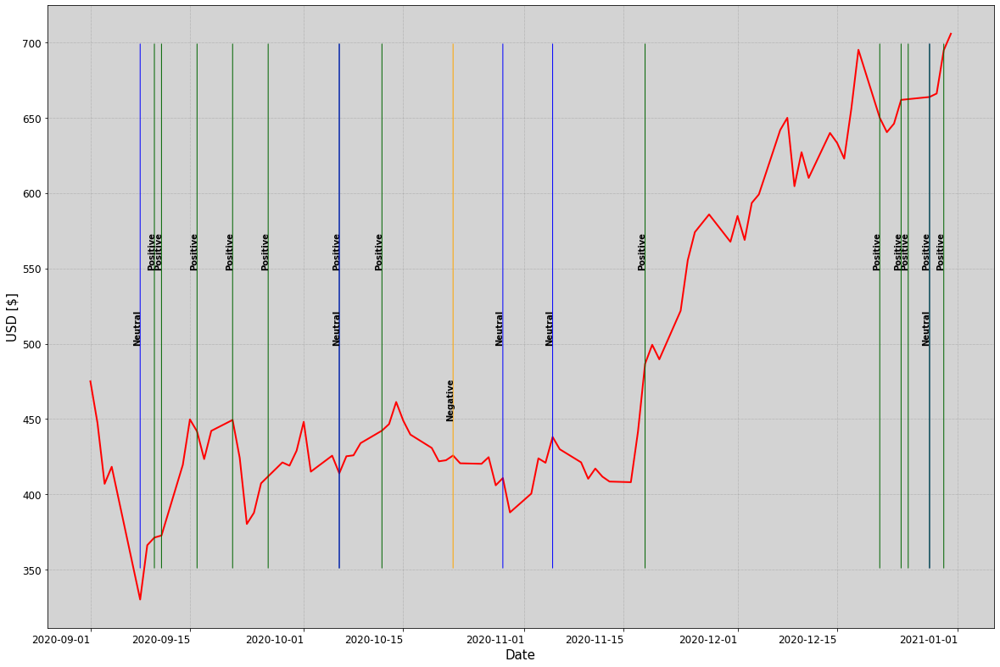

In [515]:
#x_lims = list(map(dt.datetime.fromtimestamp, [1546324311, 1641018711]))
#x_lims = mdates.date2num(x_lims)
#img = plt.imread("blacktesla.png")
ax=dft['Close'][(dft.index.year>2019) & (dft.index.year<2021) & (dft.index.month>8)].plot(figsize=(20,15),color='red',linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax.set_facecolor('lightgrey')
#ax.set_title('Tesla Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
#ax.imshow(img,aspect='auto',alpha=0.3,extent=[x_lims[0],x_lims[1],0,900])

i=0
for i in range (df2t.shape[0]):
    if df2t.iloc[i,11]>df2t.iloc[i,9]:
        y=df2t.index[i].year
        m=df2t.index[i].month
        d=df2t.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 700),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 350),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='darkgreen')
                    )
        ax.text(dt.datetime(y,m,d-1),550,'Positive',rotation='vertical',fontweight='bold')
    elif df2t.iloc[i,11]<df2t.iloc[i,9]:
        y=df2t.index[i].year
        m=df2t.index[i].month
        d=df2t.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 700),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 350),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='orange')
                    )
        ax.text(dt.datetime(y,m,d-1),450,'Negative',rotation='vertical',fontweight='bold')
    else:
        y=df2t.index[i].year
        m=df2t.index[i].month
        d=df2t.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 700),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 350),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='blue')
                    )
        ax.text(dt.datetime(y,m,d-1),500,'Neutral',rotation='vertical',fontweight='bold')

In [516]:
#only tweets and not replys
df3t=df1t[(df1t['reply_to']=='[]') & (df1t.index.year>2020)]
df3t.shape

(9, 13)

In [517]:
#df3t

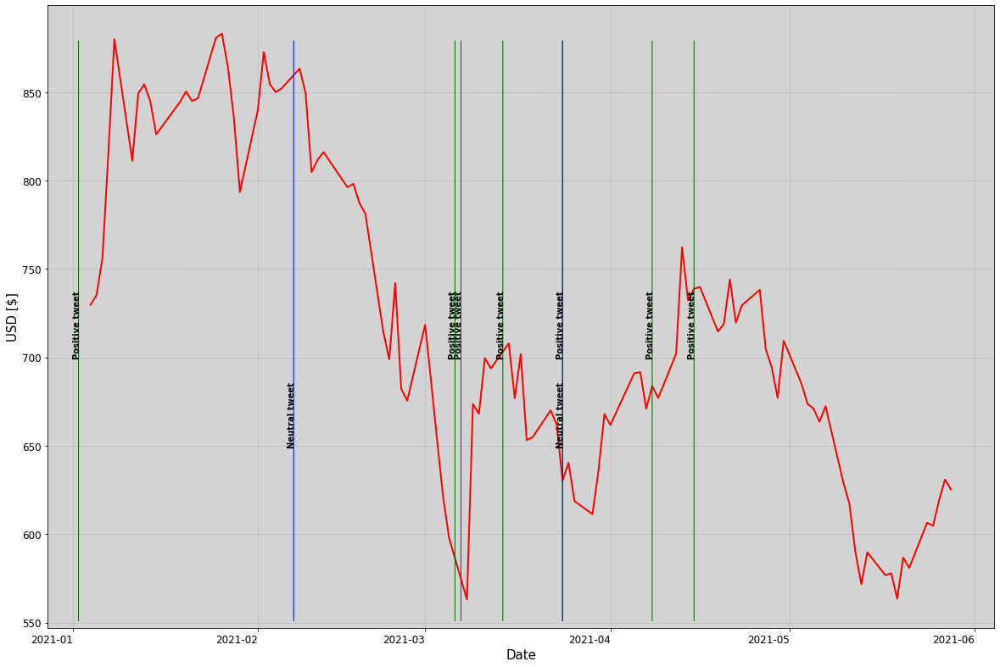

In [518]:
#x_lims = list(map(dt.datetime.fromtimestamp, [1546324311, 1641018711]))
#x_lims = mdates.date2num(x_lims)
#img = plt.imread("blacktesla.png")
ax=dft['Close'][(dft.index.year>2020) & (dft.index.month<6)].plot(figsize=(20,15),color='red',linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax.set_title('Tesla Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.set_facecolor('lightgrey')
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
#ax.imshow(img,aspect='auto',alpha=0.3,extent=[x_lims[0],x_lims[1],0,900])

i=0
for i in range (df3t.shape[0]):
    if df3t.iloc[i,11]>df3t.iloc[i,9]:
        y=df3t.index[i].year
        m=df3t.index[i].month
        d=df3t.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 880),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 550),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='darkgreen')
                    )
        ax.text(dt.datetime(y,m,d-1),700,'Positive tweet',rotation='vertical',fontweight='bold')
    elif df3t.iloc[i,11]<df3t.iloc[i,9]:
        y=df3t.index[i].year
        m=df3t.index[i].month
        d=df3t.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 880),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 550),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='orange')
                    )
        ax.text(dt.datetime(y,m,d-1),600,'Negative tweet',rotation='vertical',fontweight='bold')
    else:
        y=df3t.index[i].year
        m=df3t.index[i].month
        d=df3t.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 880),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 550),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='blue')
                    )
        ax.text(dt.datetime(y,m,d-1),650,'Neutral tweet',rotation='vertical',fontweight='bold')

### In the above two graphs, from September 2020 until June 2021 we see the trend of the price everytime Elon Musk tweets about tesla. (green line for Positive, blue for Neutral and yellow for Negative tweets). We can see some rises and falls of the price but we will check it more accurately with calculations. We will calculate the ratio of the tesla stock closed price seven days after the tweet and compare it to the day of the tweet. We can also see that positve tweets are more than negatives from the above plots.

In [519]:
#Create a new column with five days added to the index
df1t['plus7']=pd.DatetimeIndex(df1t.index)+pd.DateOffset(7)
df1t['plus1']=pd.DatetimeIndex(df1t.index)+pd.DateOffset(1)
df1t['plus8']=pd.DatetimeIndex(df1t.index)+pd.DateOffset(8)
df1t['plus9']=pd.DatetimeIndex(df1t.index)+pd.DateOffset(9)
df1t['plus2']=pd.DatetimeIndex(df1t.index)+pd.DateOffset(2)
dft['plus7']=pd.DatetimeIndex(dft.index)+pd.DateOffset(7)

<ipython-input-519-3a4cca258ba7>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-519-3a4cca258ba7>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-519-3a4cca258ba7>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-519-3a4

In [520]:
df1t.head(2)

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year,tweet_clean,neg,neu,pos,tweet_day,plus7,plus1,plus8,plus9,plus2
date,,,,,,,,,,,,,,,,,,
2021-04-10,11:32:35,@tesla_adri @wholemarsblog these things are best thought of as probabilities...,2310,204,114,[],"[{'screen_name': 'tesla_adri', 'name': 'Tesla_Adri', 'id': '1321117860844965...",2021,_adri these things are best thought of as probabilities. there are 5 forwar...,0.0,0.865,0.135,1,2021-04-17,2021-04-11,2021-04-18,2021-04-19,2021-04-12
2021-04-10,04:07:04,@austinteslaclub @owensparks_ @wholemarsblog good point. next major softwa...,2487,210,138,[],"[{'screen_name': 'AustinTeslaClub', 'name': 'Tesla Owners of Austin', 'id': ...",2021,_ good point. next major software rev will do much better with automatin...,0.0,0.823,0.177,1,2021-04-17,2021-04-11,2021-04-18,2021-04-19,2021-04-12


In [521]:
i=0
ratio_pos=[]
i_pos=[]
ratio_neg=[]
i_neg=[]
ratio_neu=[]
for i in range (df1t.shape[0]):
    x=df1t.index[i].to_pydatetime().weekday()
    if x == 6:
        d=str(df1t.iloc[i,-4].day)
        y=str(df1t.iloc[i,-4].year)
        m=str(df1t.iloc[i,-4].month)
        d1=str(df1t.iloc[i,-3].day)
        y1=str(df1t.iloc[i,-3].year)
        m1=str(df1t.iloc[i,-3].month)
    elif x==5:
        d=str(df1t.iloc[i,-1].day)
        y=str(df1t.iloc[i,-1].year)
        m=str(df1t.iloc[i,-1].month)
        d1=str(df1t.iloc[i,-2].day)
        y1=str(df1t.iloc[i,-2].year)
        m1=str(df1t.iloc[i,-2].month)
    else:
        y=str(df1t.index[i].year)
        m=str(df1t.index[i].month)
        d=str(df1t.index[i].day)
        d1=str(df1t.iloc[i,-5].day)
        y1=str(df1t.iloc[i,-5].year)
        m1=str(df1t.iloc[i,-5].month)
    time1=y+'-'+m+'-'+d
    time5=y1+'-'+m1+'-'+d1
    if (time1 in dft.index) and (time5 in dft.index): 
        ratio=(dft.loc[time5,'Close']-dft.loc[time1,'Close'])/dft.loc[time1,'Close']
    if df1t.iloc[i,11]>df1t.iloc[i,9]:
        i_pos.append(dft.index[i])
        ratio_pos.append(ratio)
    elif df1t.iloc[i,11]<df1t.iloc[i,9]:
        ratio_neg.append(ratio)
    else: 
        ratio_neu.append(ratio)
    i+=1

In [522]:
dft.head(2)

,Open,High,Low,Close,Adj Close,Volume,plus7
Date,,,,,,,
2010-06-29,3.800,5.000,3.508,4.778,4.778,93831500,2010-07-06
2010-06-30,5.158,6.084,4.660,4.766,4.766,85935500,2010-07-07


In [523]:
from collections import OrderedDict
ratio_pos=list(OrderedDict.fromkeys(ratio_pos))
len(ratio_pos)

555

In [524]:
ratio_neg=list(OrderedDict.fromkeys(ratio_neg))
len(ratio_neg)

222

In [525]:
ratio_neu=list(OrderedDict.fromkeys(ratio_neu))
len(ratio_neu)

410

In [526]:
ratio_pos[0:10]

[0.01802049255022918,
 0.0927003739121333,
 0.08050597976904321,
 0.01581649980435275,
 0.08810295528856042,
 0.1304781901724552,
 0.059752124970183285,
 -0.05359211499959858,
 0.2574422770870338,
 0.02274951887171725]

In [527]:
pos=np.average(ratio_pos)*100
pos

2.6150041258774954

In [528]:
neg=np.average(ratio_neg)*100
neg

2.3524071358918537

In [529]:
neu=np.average(ratio_neu)*100
neu

2.0962371404612314

In [530]:
pos2=pd.DataFrame(ratio_pos)
neg2=pd.DataFrame(ratio_neg)

In [531]:
pos2=pos2*100
neg2=neg2*100

In [532]:
pos2.head()

,0
0,1.802049
1,9.270037
2,8.050598
3,1.581650
4,8.810296


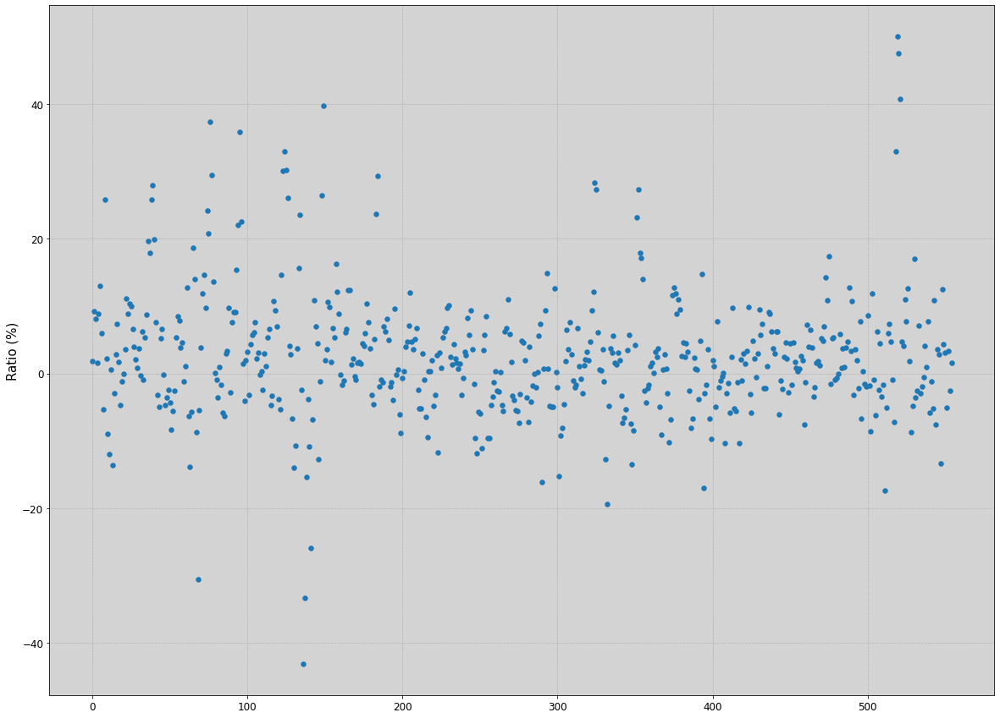

In [533]:
ax=pos2.reset_index().plot(kind='scatter',x=['index'],y=0,figsize=(20,15),linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax.set_title('Tesla Stock Close Price Week Ratio after positive tweet',fontsize=18)
ax.set_ylabel('Ratio (%)',fontsize=15)
ax.set_xlabel('',fontsize=15)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.set_facecolor('lightgrey')

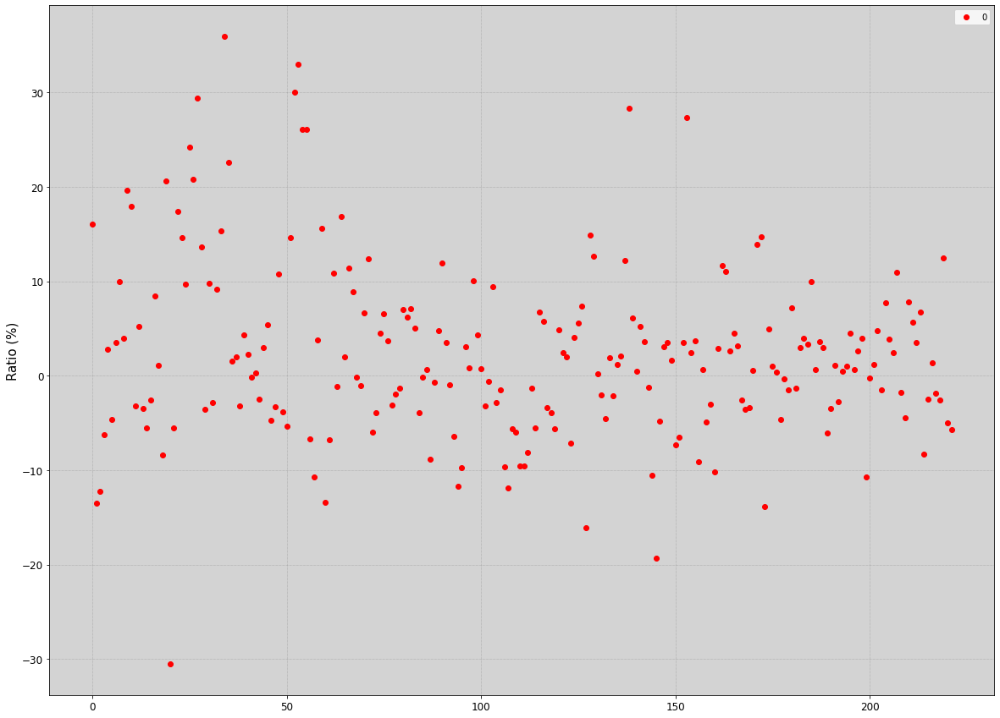

In [534]:
ax=neg2.plot(kind='line',figsize=(20,15),style='o-',linewidth=0,color='red')
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax.set_title('Tesla Stock Close Price Week Ratio after negative tweet',fontsize=18)
ax.set_ylabel('Ratio (%)',fontsize=15)
ax.set_xlabel('',fontsize=15)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.set_facecolor('lightgrey')

## In the above two graphs we have the week ratio of the Tesla stock close price after every positive tweet (blue line) and after every negative tweet (red line). We see the ratio every time he positively tweets about tesla is slightly higher than when he negatively tweets. The maximum ratio after one positive tweet was around 50%. By saying ratio, we calculate: the difference between the close stock price a week after the tweet and the close stock price the day of the tweet divided  by the stock price the day of the tweet.

## Even though the ratio is higher for positive tweets is higher than for negative tweets, we will compare this ratio to normal. Normal means even if Elon Musk tweets or not.

In [535]:
dft.head(2)

,Open,High,Low,Close,Adj Close,Volume,plus7
Date,,,,,,,
2010-06-29,3.800,5.000,3.508,4.778,4.778,93831500,2010-07-06
2010-06-30,5.158,6.084,4.660,4.766,4.766,85935500,2010-07-07


In [536]:
ratio=[]
i=0
for i in range (dft.shape[0]-7):
    ratio1=((dft.iloc[(i+7),3]-dft.iloc[i,3])/dft.iloc[i,3])
    ratio.append(ratio1)
    i+=1

In [537]:
len(ratio)

2834

In [538]:
norm=np.average(ratio)*100
norm

1.7485153741790467

In [539]:
total_ratios=pd.DataFrame(data=(norm,neu,neg,pos))

In [540]:
total_ratios.T

,0,1,2,3
0,1.748515,2.096237,2.352407,2.615004


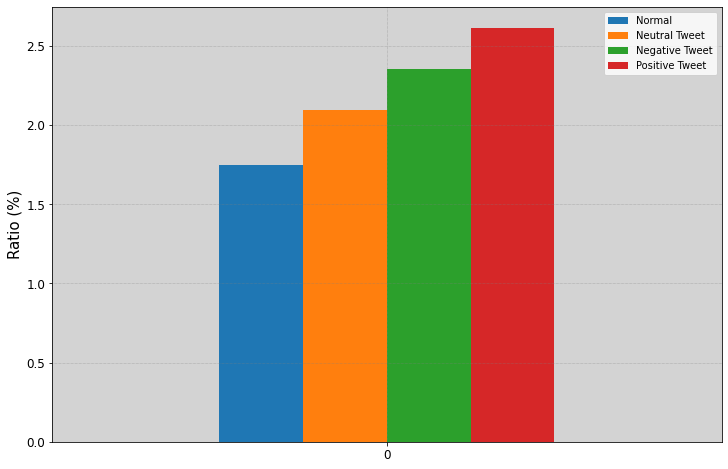

In [541]:
ax1=total_ratios.T[[0,1,2,3]].plot(kind='bar',figsize=(12,8))
ax1.set_ylabel('Ratio (%)',fontsize=15)
ax1.set_facecolor('lightgrey')
ax1.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax1.set_title('Increasing ratio of Tesla stock',fontsize=16)
ax1.legend(['Normal','Neutral Tweet','Negative Tweet','Positive Tweet'])
ax1.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax1.tick_params(axis='y',which='major',labelsize=12)

## From the above graph we can see that every time he tweets about tesla, it doesn't matter if the sentiment is positive, negative or neutral, the ratio is slightly higher than the normal ratio. The ratio of the tesla stock is always positive since the stock price is increasing over the years.

## Bitcoin

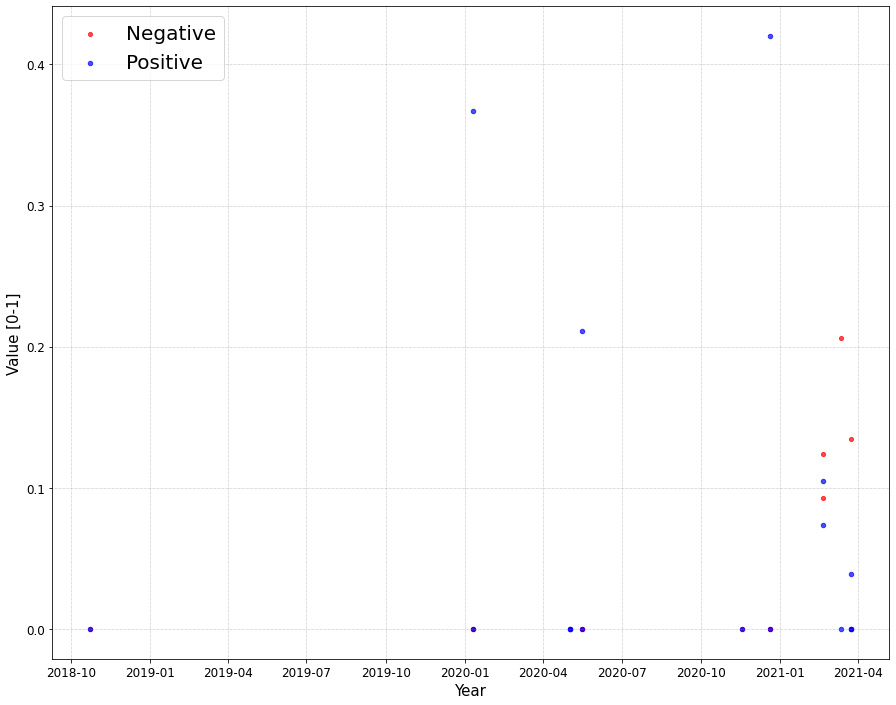

In [542]:
ax1=df1b.reset_index().plot(kind='scatter',x='date',y='neg',figsize=(15,12),s=17,color='red',ylabel='value [0-1]',alpha=0.7)
ax2=ax1
ax2=df1b.reset_index().plot(kind='scatter',x='date',y='pos',color='blue',s=20,ax=ax2,alpha=0.7)
#ax2.set_facecolor('lightgrey')
ax2.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax2.set_ylabel('Value [0-1]',fontsize=15)
ax2.set_xlabel('Year',fontsize=15)
ax2.tick_params(axis='both',which='major',labelsize=12)
#ax2.set_title('Positive and Negative value of the tweets from Sentiment analysis for Bitcoin',fontsize=16)
ax2.legend(['Negative','Positive'],loc='upper left',fontsize=20)

In [543]:
#only tweets and not replys
df2b=df1b[(df1b['reply_to']=='[]') & (df1b.index.year>2019)]
df2b.shape

(7, 12)

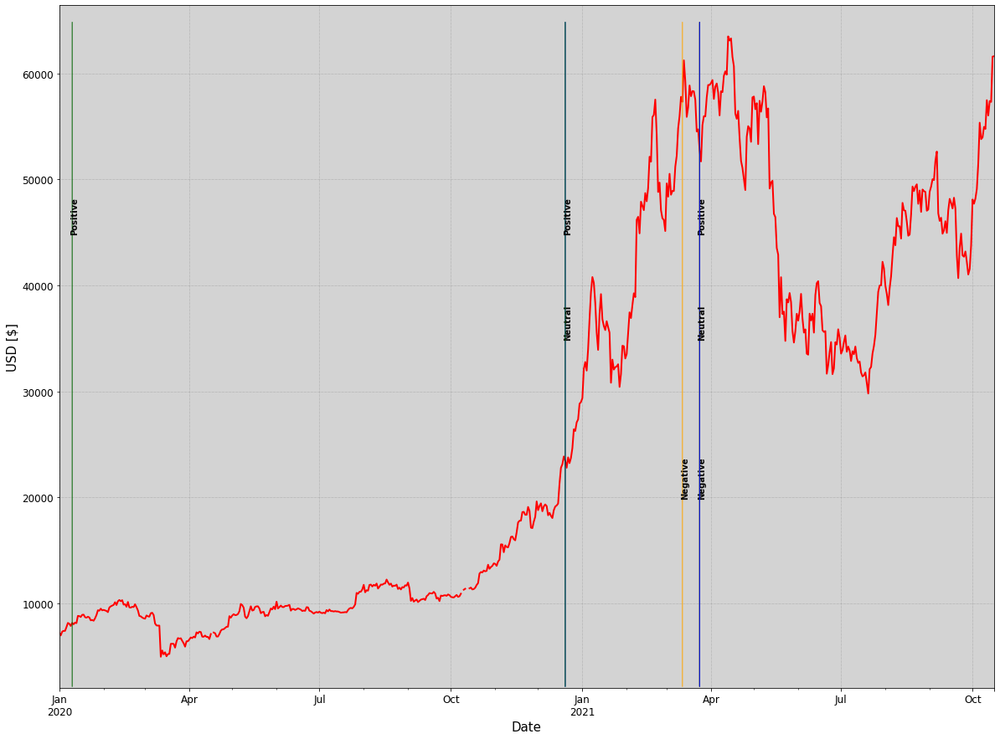

In [544]:
#x_lims = list(map(dt.datetime.fromtimestamp, [1546324311, 1641018711]))
#x_lims = mdates.date2num(x_lims)
#img = plt.imread("blacktesla.png")
ax=dfb['Close'][(dfb.index.year>2019)].plot(figsize=(20,15),color='red',linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax.set_facecolor('lightgrey')
#ax.set_title('Tesla Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
#ax.imshow(img,aspect='auto',alpha=0.3,extent=[x_lims[0],x_lims[1],0,900])

i=0
for i in range (df2b.shape[0]):
    if df2b.iloc[i,11]>df2b.iloc[i,9]:
        y=df2b.index[i].year
        m=df2b.index[i].month
        d=df2b.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 65000),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 2000),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='darkgreen')
                    )
        ax.text(dt.datetime(y,m,d-1),45000,'Positive',rotation='vertical',fontweight='bold')
    elif df2b.iloc[i,11]<df2b.iloc[i,9]:
        y=df2b.index[i].year
        m=df2b.index[i].month
        d=df2b.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 65000),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 2000),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='orange')
                    )
        ax.text(dt.datetime(y,m,d-1),20000,'Negative',rotation='vertical',fontweight='bold')
    else:
        y=df2b.index[i].year
        m=df2b.index[i].month
        d=df2b.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 65000),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d),2000),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='blue')
                    )
        ax.text(dt.datetime(y,m,d-1),35000,'Neutral',rotation='vertical',fontweight='bold')

In [545]:
#Create a new column with five days added to the index
df1b['plus7']=pd.DatetimeIndex(df1b.index)+pd.DateOffset(7)
df1b['plus1']=pd.DatetimeIndex(df1b.index)+pd.DateOffset(1)
df1b['plus8']=pd.DatetimeIndex(df1b.index)+pd.DateOffset(8)
df1b['plus9']=pd.DatetimeIndex(df1b.index)+pd.DateOffset(9)
df1b['plus2']=pd.DatetimeIndex(df1b.index)+pd.DateOffset(2)
dfb['plus7']=pd.DatetimeIndex(dfb.index)+pd.DateOffset(7)

<ipython-input-545-a11afc924fe5>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-545-a11afc924fe5>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-545-a11afc924fe5>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-545-a11

In [546]:
df1b.head(2)

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year,tweet_clean,neg,neu,pos,plus7,plus1,plus8,plus9,plus2
date,,,,,,,,,,,,,,,,,
2021-03-24,09:10:43,pay by bitcoin capability available outside us later this year,141418,3152,9279,[],[],2021,pay by bitcoin capability available outside us later this year,0.135,0.865,0.000,2021-03-31,2021-03-25,2021-04-01,2021-04-02,2021-03-26
2021-03-24,09:09:34,tesla is using only internal &amp; open source software &amp; operates bitco...,179638,4675,20572,[],[],2021,tesla is using only internal &amp; open source software &amp; operates bitco...,0.000,0.961,0.039,2021-03-31,2021-03-25,2021-04-01,2021-04-02,2021-03-26


In [547]:
i=0
ratio_pos=[]
i_pos=[]
ratio_neg=[]
i_neg=[]
ratio_neu=[]
for i in range (df1b.shape[0]):
    x=df1b.index[i].to_pydatetime().weekday()
    if x == 6:
        d=str(df1b.iloc[i,-4].day)
        y=str(df1b.iloc[i,-4].year)
        m=str(df1b.iloc[i,-4].month)
        d1=str(df1b.iloc[i,-3].day)
        y1=str(df1b.iloc[i,-3].year)
        m1=str(df1b.iloc[i,-3].month)
    elif x==5:
        d=str(df1b.iloc[i,-1].day)
        y=str(df1b.iloc[i,-1].year)
        m=str(df1b.iloc[i,-1].month)
        d1=str(df1b.iloc[i,-2].day)
        y1=str(df1b.iloc[i,-2].year)
        m1=str(df1b.iloc[i,-2].month)
    else:
        y=str(df1b.index[i].year)
        m=str(df1b.index[i].month)
        d=str(df1b.index[i].day)
        d1=str(df1b.iloc[i,-5].day)
        y1=str(df1b.iloc[i,-5].year)
        m1=str(df1b.iloc[i,-5].month)
    time1=y+'-'+m+'-'+d
    time5=y1+'-'+m1+'-'+d1
    if (time1 in dfb.index) and (time5 in dfb.index): 
        ratio=(dfb.loc[time5,'Close']-dfb.loc[time1,'Close'])/dfb.loc[time1,'Close']
    if df1b.iloc[i,11]>df1b.iloc[i,9]:
        i_pos.append(dfb.index[i])
        ratio_pos.append(ratio)
    elif df1b.iloc[i,11]<df1b.iloc[i,9]:
        ratio_neg.append(ratio)
    else: 
        ratio_neu.append(ratio)
    i+=1

In [548]:
from collections import OrderedDict
ratio_pos=list(OrderedDict.fromkeys(ratio_pos))
len(ratio_pos)

4

In [549]:
ratio_neg=list(OrderedDict.fromkeys(ratio_neg))
len(ratio_neg)

3

In [550]:
ratio_neu=list(OrderedDict.fromkeys(ratio_neu))
len(ratio_neu)

7

In [551]:
pos=np.average(ratio_pos)*100
neg=np.average(ratio_neg)*100
neu=np.average(ratio_neu)*100
pos2=pd.DataFrame(ratio_pos)
neg2=pd.DataFrame(ratio_neg)
neu2=pd.DataFrame(ratio_neu)
pos2=pos2*100
neg2=neg2*100
neu2=neu2*100

In [552]:
neu2[1]=pos2[0]
neu2[2]=neg2[0]

In [553]:
neu2

,0,1,2
0,11.643111,11.643111,11.643111
1,18.776964,18.776964,1.769624
2,8.285775,-8.426816,-17.084792
3,-8.426816,9.336666,NaN
4,-3.487832,NaN,NaN
5,9.336666,NaN,NaN
6,-2.184618,NaN,NaN


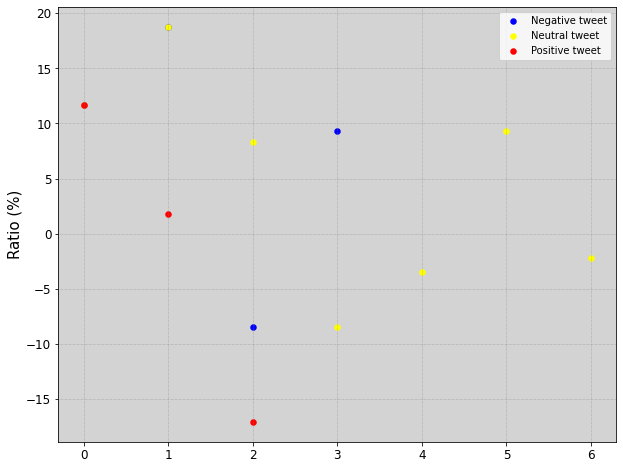

In [554]:
ax1=neu2.reset_index().plot(kind='scatter',x=['index'],y=1,figsize=(10,8),linewidth=2,color='blue')
ax2=neu2.reset_index().plot(kind='scatter',x=['index'],y=0,figsize=(10,8),linewidth=2,color='yellow',ax=ax1)
ax=neu2.reset_index().plot(kind='scatter',x=['index'],y=2,figsize=(10,8),linewidth=2,ax=ax1,color='red')
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax.set_title('Bitcoin Stock Close Price Week Ratio after positive tweet',fontsize=18)
ax.set_ylabel('Ratio (%)',fontsize=15)
ax.set_xlabel('',fontsize=15)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.set_facecolor('lightgrey')
ax.legend(['Negative tweet','Neutral tweet','Positive tweet'])

In [555]:
ratio=[]
i=0
for i in range (dfb.shape[0]-7):
    ratio1=((dfb.iloc[(i+7),3]-dfb.iloc[i,3])/dfb.iloc[i,3])
    ratio.append(ratio1)
    i+=1

In [556]:
ratio = ratio[np.logical_not(np.isnan(x))]

<ipython-input-556-d83c2d5699b0>:1: DeprecationWarning:

In future, it will be an error for 'np.bool_' scalars to be interpreted as an index



In [557]:
norm=np.average(ratio)*100
total_ratios=pd.DataFrame(data=(norm,neu,neg,pos))

In [558]:
norm

-3.031287564643823

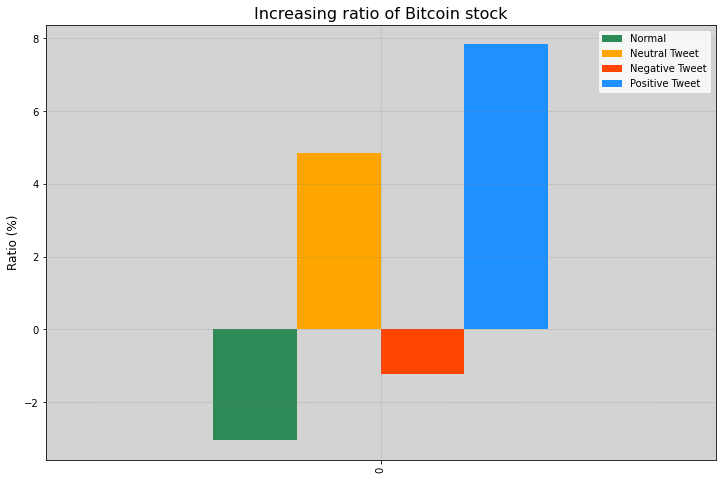

In [559]:
ax1=total_ratios.T[[0,1,2,3]].plot(kind='bar',figsize=(12,8),color=['seagreen','orange','orangered','dodgerblue'])
ax1.set_ylabel('Ratio (%)',fontsize=12)
ax1.set_facecolor('lightgrey')
ax1.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax1.set_title('Increasing ratio of Bitcoin stock',fontsize=16)
ax1.legend(['Normal','Neutral Tweet','Negative Tweet','Positive Tweet'])

# Dogecoin

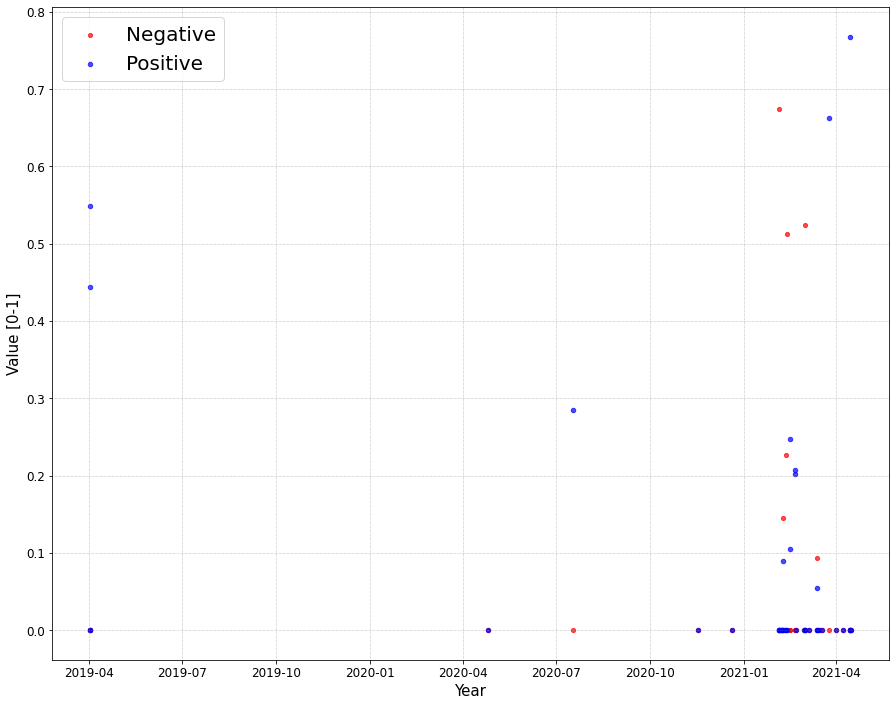

In [560]:
ax1=df1d.reset_index().plot(kind='scatter',x='date',y='neg',figsize=(15,12),s=17,color='red',ylabel='value [0-1]',alpha=0.7)
ax2=ax1
ax2=df1d.reset_index().plot(kind='scatter',x='date',y='pos',color='blue',s=20,ax=ax2,alpha=0.7)
#ax2.set_facecolor('lightgrey')
ax2.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax2.set_ylabel('Value [0-1]',fontsize=15)
ax2.set_xlabel('Year',fontsize=15)
ax2.tick_params(axis='both',which='major',labelsize=12)
#ax2.set_title('Positive and Negative value of the tweets from Sentiment analysis for Bitcoin',fontsize=16)
ax2.legend(['Negative','Positive'],loc='upper left',fontsize=20)

In [561]:
#only tweets and not replys
df2d=df1d[(df1d.index.year>2020)]
df2d.shape

(33, 12)

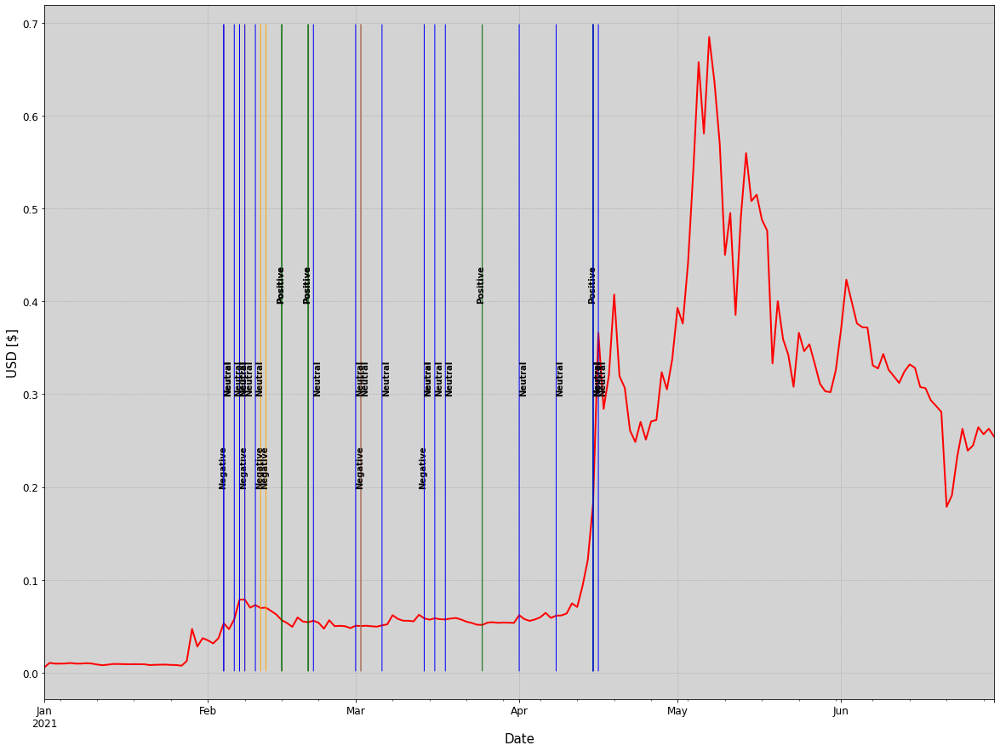

In [562]:
#x_lims = list(map(dt.datetime.fromtimestamp, [1546324311, 1641018711]))
#x_lims = mdates.date2num(x_lims)
#img = plt.imread("blacktesla.png")
ax=dfd['Close'][(dfd.index.year>2020)&(dfd.index.month<7)].plot(figsize=(20,15),color='red',linewidth=2)
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax.set_facecolor('lightgrey')
#ax.set_title('Tesla Stock Daily Close Value',fontsize=18)
ax.set_ylabel('USD [$]',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
#ax.imshow(img,aspect='auto',alpha=0.3,extent=[x_lims[0],x_lims[1],0,900])

i=0
for i in range (df2d.shape[0]):
    if df2d.iloc[i,11]>df2d.iloc[i,9]:
        y=df2d.index[i].year
        m=df2d.index[i].month
        d=df2d.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 0),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 0.70),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='darkgreen')
                    )
        ax.text(dt.datetime(y,m,d-1),0.4,'Positive',rotation='vertical',fontweight='bold')
    elif df2d.iloc[i,11]<df2d.iloc[i,9]:
        y=df2d.index[i].year
        m=df2d.index[i].month
        d=df2d.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 0),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d), 0.7),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='orange')
                    )
        ax.text(dt.datetime(y,m,d-1),0.2,'Negative',rotation='vertical',fontweight='bold')
    else:
        y=df2d.index[i].year
        m=df2d.index[i].month
        d=df2d.index[i].day
        ax.annotate('',                      # s: str. Will leave it blank for no text
                     xy=(dt.datetime(y,m,d), 0),             # place head of the arrow at point (year 2012 , pop 70)
                     xytext=(dt.datetime(y,m,d),0.7),         # place base of the arrow at point (year 2008 , pop 20)
                     xycoords='data',         # will use the coordinate system of the object being annotated 
                     arrowprops=dict(arrowstyle='-',connectionstyle='arc3', color='blue')
                    )
        ax.text(dt.datetime(y,m,d),0.3,'Neutral',rotation='vertical',fontweight='bold')

In [563]:
#Create a new column with five days added to the index
df1d['plus7']=pd.DatetimeIndex(df1d.index)+pd.DateOffset(7)
df1d['plus1']=pd.DatetimeIndex(df1d.index)+pd.DateOffset(1)
df1d['plus8']=pd.DatetimeIndex(df1d.index)+pd.DateOffset(8)
df1d['plus9']=pd.DatetimeIndex(df1d.index)+pd.DateOffset(9)
df1d['plus2']=pd.DatetimeIndex(df1d.index)+pd.DateOffset(2)
dfd['plus7']=pd.DatetimeIndex(dfd.index)+pd.DateOffset(7)

<ipython-input-563-688d66f9b0a2>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-563-688d66f9b0a2>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-563-688d66f9b0a2>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-563-688

In [564]:
i=0
ratio_pos=[]
i_pos=[]
ratio_neg=[]
i_neg=[]
ratio_neu=[]
for i in range (df1d.shape[0]):
    x=df1d.index[i].to_pydatetime().weekday()
    if x == 6:
        d=str(df1d.iloc[i,-4].day)
        y=str(df1d.iloc[i,-4].year)
        m=str(df1d.iloc[i,-4].month)
        d1=str(df1d.iloc[i,-3].day)
        y1=str(df1d.iloc[i,-3].year)
        m1=str(df1d.iloc[i,-3].month)
    elif x==5:
        d=str(df1d.iloc[i,-1].day)
        y=str(df1d.iloc[i,-1].year)
        m=str(df1d.iloc[i,-1].month)
        d1=str(df1d.iloc[i,-2].day)
        y1=str(df1d.iloc[i,-2].year)
        m1=str(df1d.iloc[i,-2].month)
    else:
        y=str(df1d.index[i].year)
        m=str(df1d.index[i].month)
        d=str(df1d.index[i].day)
        d1=str(df1d.iloc[i,-5].day)
        y1=str(df1d.iloc[i,-5].year)
        m1=str(df1d.iloc[i,-5].month)
    time1=y+'-'+m+'-'+d
    time5=y1+'-'+m1+'-'+d1
    if (time1 in dfd.index) and (time5 in dfd.index): 
        ratio=(dfd.loc[time5,'Close']-dfd.loc[time1,'Close'])/dfd.loc[time1,'Close']
    if df1d.iloc[i,11]>df1d.iloc[i,9]:
        i_pos.append(dfd.index[i])
        ratio_pos.append(ratio)
    elif df1d.iloc[i,11]<df1d.iloc[i,9]:
        ratio_neg.append(ratio)
    else: 
        ratio_neu.append(ratio)
    i+=1

In [565]:
from collections import OrderedDict
ratio_pos=list(OrderedDict.fromkeys(ratio_pos))
len(ratio_pos)

6

In [566]:
ratio_neg=list(OrderedDict.fromkeys(ratio_neg))
len(ratio_neg)

6

In [567]:
ratio_neu=list(OrderedDict.fromkeys(ratio_neu))
len(ratio_neu)

18

In [568]:
pos=np.average(ratio_pos)*100
neg=np.average(ratio_neg)*100
neu=np.average(ratio_neu)*100
pos2=pd.DataFrame(ratio_pos)
neg2=pd.DataFrame(ratio_neg)
neu2=pd.DataFrame(ratio_neu)
pos2=pos2*100
neg2=neg2*100
neu2=neu2*100

In [569]:
neu2[1]=pos2[0]
neu2[2]=neg2[0]

In [570]:
neu2

,0,1,2
0,196.445074,20.482818,-3.724075
1,-0.842126,-5.818520,15.391349
2,-10.342784,-5.064410,-21.307568
3,-8.618424,-2.655140,-14.545898
4,-3.724075,3.184258,-28.206787
5,-7.846777,43.225562,30.751187
6,15.391349,NaN,NaN
7,22.431273,NaN,NaN
8,-5.818520,NaN,NaN
9,-32.265145,NaN,NaN


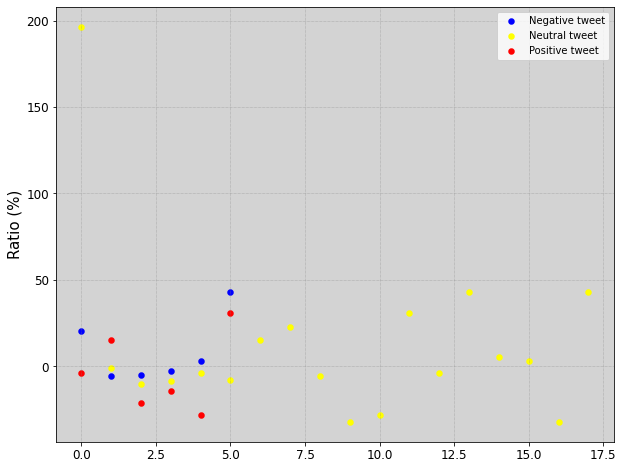

In [571]:
ax1=neu2.reset_index().plot(kind='scatter',x=['index'],y=1,figsize=(10,8),linewidth=2,color='blue')
ax2=neu2.reset_index().plot(kind='scatter',x=['index'],y=0,figsize=(10,8),linewidth=2,color='yellow',ax=ax1)
ax=neu2.reset_index().plot(kind='scatter',x=['index'],y=2,figsize=(10,8),linewidth=2,ax=ax1,color='red')
ax.grid(color='grey', linestyle='dotted', linewidth=0.5)
#ax.set_title('Bitcoin Stock Close Price Week Ratio after positive tweet',fontsize=18)
ax.set_ylabel('Ratio (%)',fontsize=15)
ax.set_xlabel('',fontsize=15)
ax.tick_params(axis='x',which='major',labelsize=12,labelrotation=0)
ax.tick_params(axis='y',which='major',labelsize=12)
ax.set_facecolor('lightgrey')
ax.legend(['Negative tweet','Neutral tweet','Positive tweet'])

In [572]:
df1d[df1d['reply_to']=='[]']

,time,tweet,likes_count,replies_count,retweets_count,photos,reply_to,year,tweet_clean,neg,neu,pos,plus7,plus1,plus8,plus9,plus2
date,,,,,,,,,,,,,,,,,
2021-04-01,13:25:23,spacex is going to put a literal dogecoin on the literal moon,535373,25947,50139,[],[],2021,spacex is going to put a literal dogecoin on the literal moon,0.000,1.000,0.000,2021-04-08,2021-04-02,2021-04-09,2021-04-10,2021-04-03
2021-03-14,01:51:05,"why are you so dogematic, they ask",247187,9666,19545,[],[],2021,"why are you so dogematic, they ask",0.000,1.000,0.000,2021-03-21,2021-03-15,2021-03-22,2021-03-23,2021-03-16
2021-03-14,01:46:16,origin of doge day afternoon: the ancient romans sacrificed a dogecoin at th...,76253,2482,7826,[],[],2021,origin of doge day afternoon: the ancient romans sacrificed a dogecoin at th...,0.093,0.853,0.054,2021-03-21,2021-03-15,2021-03-22,2021-03-23,2021-03-16
2021-03-14,01:40:41,doge day afternoon,176062,7411,18877,[],[],2021,doge day afternoon,0.000,1.000,0.000,2021-03-21,2021-03-15,2021-03-22,2021-03-23,2021-03-16
2021-03-06,06:40:30,doge spelled backwards is egod,409756,20999,38440,[],[],2021,doge spelled backwards is egod,0.000,1.000,0.000,2021-03-13,2021-03-07,2021-03-14,2021-03-15,2021-03-08
2021-03-01,21:57:08,doge meme shield (legendary item) https://t.co/ceomu9q84c,283691,9506,26638,['https://pbs.twimg.com/media/Eva0KLkVkAIE0Mw.jpg'],[],2021,doge meme shield (legendary item),0.000,1.000,0.000,2021-03-08,2021-03-02,2021-03-09,2021-03-10,2021-03-03
2021-02-21,23:27:06,dojo 4 doge,328590,19992,33212,[],[],2021,dojo 4 doge,0.000,1.000,0.000,2021-02-28,2021-02-22,2021-03-01,2021-03-02,2021-02-23
2021-02-15,01:25:16,"if major dogecoin holders sell most of their coins, it will get my full supp...",332146,29046,35001,[],[],2021,"if major dogecoin holders sell most of their coins, it will get my full supp...",0.000,0.895,0.105,2021-02-22,2021-02-16,2021-02-23,2021-02-24,2021-02-17
2021-02-11,11:08:33,"frodo was the underdoge, all thought he would fail, himself most of all. ht...",248030,19831,30389,['https://pbs.twimg.com/media/Et7zD1sWYAAFoDq.jpg'],[],2021,"frodo was the underdoge, all thought he would fail, himself most of all.",0.226,0.774,0.000,2021-02-18,2021-02-12,2021-02-19,2021-02-20,2021-02-13


In [573]:
ratio=[]
i=0
for i in range (dfd.shape[0]-7):
    ratio1=((dfd.iloc[(i+7),3]-dfd.iloc[i,3])/dfd.iloc[i,3])
    ratio.append(ratio1)
    i+=1

In [574]:
len(ratio)

2587

In [575]:
ratio = ratio[np.logical_not(np.isnan(x))]

<ipython-input-575-d83c2d5699b0>:1: DeprecationWarning:

In future, it will be an error for 'np.bool_' scalars to be interpreted as an index



In [576]:
norm=np.average(ratio)*100
total_ratios=pd.DataFrame(data=(norm,neu,neg,pos))

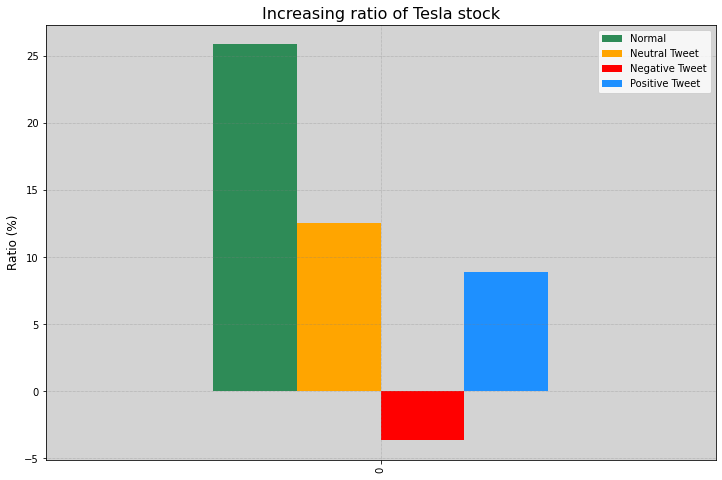

In [577]:
ax1=total_ratios.T[[0,1,2,3]].plot(kind='bar',figsize=(12,8),color=['seagreen','orange','red','dodgerblue'])
ax1.set_ylabel('Ratio (%)',fontsize=12)
ax1.set_facecolor('lightgrey')
ax1.grid(color='grey', linestyle='dotted', linewidth=0.5)
ax1.set_title('Increasing ratio of Tesla stock',fontsize=16)
ax1.legend(['Normal','Neutral Tweet','Negative Tweet','Positive Tweet'])

### P.S. The above analysis will be done as well for Bitcoin and Dogecoin

# 3. Limitations

#### Regarding the limitations, further time series analysis can be done before proceeding to further analysis of the stock price correlation with the tweets. This is because, it is observed that the price is increasing more when Elon Musk tweets, this might be random and affected by other factors. This can be checked in further analysis. In addition, other factors like anouncing of new car model or new factories to influence more the price of the stock.

# 4. References:
###  [A] Elon Musk’s Twitter and Its Correlation with Tesla’s Stock Market - Daniel Pyeong Kang Kim, Jongwhee Lee, Jeanne Suh
###  [B] Detecting the sentiment on Elon Musk’s tweets with Python - Juan Cruz Martinez
###  [C] EPL448: Data Mining on the Web – Lab 11 - Pavlos Antoniou
###  [D] Data from Kaggle